In [1]:
import os
from tempfile import tempdir
from time import time
from turtle import color
from unittest.mock import NonCallableMagicMock
import pandas as pd
import numpy as np
import warnings
import math
import re
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

import seaborn as sns
warnings.filterwarnings("ignore")

import sys
sys.path.append("./")

from pathlib import Path

import tqdm
import importlib

import matplotlib.pyplot as plt
# from PySide2.QtWidgets import QFileDialog, QApplication
# from PySide2.QtCore import Qt
from copy import copy 

from corems.mass_spectra.input import rawFileReader
from corems.molecular_id.factory.classification import HeteroatomsClassification, Labels
from corems.molecular_id.search.priorityAssignment import OxygenPriorityAssignment
from corems.molecular_id.search.molecularFormulaSearch import SearchMolecularFormulas
from corems.encapsulation.factory.parameters import MSParameters
from corems.encapsulation.constant import Atoms
from corems.mass_spectrum.calc.Calibration import MzDomainCalibration

import corems.lc_icpms_ftms.calc.lc_icrms_qc_assign as icrms
import corems.lc_icpms_ftms.calc.lc_icrms_helpers as lcmsfns
import corems.lc_icpms_ftms.calc.align_icpms_esi_fns as algnfns

import importlib

from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

drive_dir = '/Users/christiandewey/Library/CloudStorage/GoogleDrive-christian.w.dewey@gmail.com/My Drive/manuscripts/2023_Dewey-Boiteau-etal_mz-windowing/' 
svdir = drive_dir + 'figures/'
rawfiledir = '/Volumes/Samsung_T5/NHMFL/mzwindowing/pos/spring/'


In [2]:
class Assignments:
    ''' 1 Mar 23
        Author: Christian Dewey
        
        intended for m/z windowing project
        works for 200 and 1000 m/z windows 
    '''
    def __init__(self, processed_assignments, mzrange, dataset_name):
        
        self._data_df = processed_assignments

        self.mzrange = mzrange

        self.dataset_name = dataset_name
        
        self.subsetByWindow()

        self.subsetAssignedUnique()

        self.combine()

        self.determineOverlap()


    def subsetByWindow(self):
        # create subsets of assignments based m/z window
        list200mz = []
        listfullzmz = [] 
        for mzwindow in self._data_df['Window Size (m/z)'].unique():

            r_df = self._data_df[self._data_df['Window Size (m/z)'] == mzwindow]

            if (mzwindow =='200'):
                list200mz.append(r_df) 

            elif (mzwindow =='1000'):
                listfullzmz.append(r_df) 

        self.mz200 = pd.concat(list200mz,ignore_index=True)
        self.mzfull = pd.concat(listfullzmz,ignore_index=True)

        self.mzfull_range = self.mzfull[(self.mzfull['m/z']>=self.mzrange[0])]
        self.mzfull_range = self.mzfull_range[(self.mzfull_range['m/z']<=self.mzrange[1])]

    def subsetAssignedUnique(self):
        # create subsets of assigned features and unique features 

        self.assigned_200mz = self.mz200[~self.mz200['Molecular Formula'].isnull()]
        self.assigned_fullmz = self.mzfull[~self.mzfull['Molecular Formula'].isnull()]  

        self.unique_200mz = lcmsfns.getUniqueFeatures(self.assigned_200mz)  ######
        self.unique_fullmz = lcmsfns.getUniqueFeatures(self.assigned_fullmz) #####

        self.assigned_fullmz_range = self.assigned_fullmz[(self.assigned_fullmz['m/z']>=self.mzrange[0])]
        self.assigned_fullmz_range = self.assigned_fullmz_range[(self.assigned_fullmz_range['m/z']<=self.mzrange[1])]
        self.unique_fullmz_range = lcmsfns.getUniqueFeatures(self.assigned_fullmz_range) #####

        print('200 m/z rep averaging..')
        self.rep_combined_200mz = lcmsfns.repCombine_spring(self.unique_200mz)
        print('%s features in rep_combined_100mz' %len(self.rep_combined_200mz))
        print('1000 m/z (narrow range) rep averaging..')
        self.rep_combined_fullmz_range = lcmsfns.repCombine_spring(self.unique_fullmz_range)
        print('%s features in rep_combined_fullmz_range' %len(self.rep_combined_fullmz_range))
        print('1000 m/z (full) rep averaging..')
        self.rep_combined_fullmz = lcmsfns.repCombine_spring(self.unique_fullmz)
        print('%s features in rep_combined_fullmz' %len(self.rep_combined_fullmz))

        self.blank_sub_assigned_unique_100mz = lcmsfns.blankSubtract(self.rep_combined_200mz, blnkthresh = 0.6)
        self.blank_sub_assigned_unique_fullmz_range = lcmsfns.blankSubtract(self.rep_combined_fullmz_range, blnkthresh = 0.6)
        self.blank_sub_assigned_unique_fullmz = lcmsfns.blankSubtract(self.rep_combined_fullmz, blnkthresh = 0.6)

    

        print('\n200 m/z window (narrow):')
        print('%s features total\n%s assigned (%.1f%%)\n%s unique\n%s unique & rep-avd\n%s unique, bs, rep-avd' %(np.shape(self.mz200)[0],  np.shape(self.assigned_200mz)[0], 
                                                                     (np.shape(self.assigned_200mz)[0] / np.shape(self.mz200)[0] * 100), 
                                                                     np.shape(self.unique_200mz)[0],
                                                                     len(self.rep_combined_200mz),len(self.blank_sub_assigned_unique_100mz)))
        
        print('\n200-1200 m/z window, between %s-%s m/z:' %(self.mzrange[0],self.mzrange[1]))
        print('%s features total\n%s assigned (%.1f%%)\n%s unique\n%s unique & rep-avd\n%s unique, bs, rep-avd' %(np.shape(self.mzfull_range)[0],np.shape(self.assigned_fullmz_range)[0],  
                                                                     np.shape(self.assigned_fullmz_range)[0] / np.shape(self.mzfull_range)[0] * 100, 
                                                                     len(self.unique_fullmz_range),
                                                                     len(self.rep_combined_fullmz_range),
                                                                     len(self.blank_sub_assigned_unique_fullmz_range)))
        
        print('\n200-1200 m/z window (full):')
        print('%s features total\n%s assigned (%.1f%%)\n%s unique\n%s unique & rep-avd\n%s unique, bs, rep-avd' %(np.shape(self.mzfull)[0],np.shape(self.assigned_fullmz)[0],  
                                                                     (np.shape(self.assigned_fullmz)[0] / np.shape(self.mzfull)[0] * 100),
                                                                     np.shape(self.unique_fullmz)[0],
                                                                     len(self.rep_combined_fullmz),
                                                                     len(self.blank_sub_assigned_unique_fullmz)))

    def combine(self):
        # get combo unique 
        self.combo_assigned = pd.concat([self.assigned_200mz, self.assigned_fullmz_range], ignore_index=True)
        #self.combo_unique = lcmsfns.getUniqueFeatures(self.combo_assigned)
        self.combo_unique =  pd.concat([self.unique_200mz, self.unique_fullmz_range], ignore_index=True)
        self.combo_bs = pd.concat([self.blank_sub_assigned_unique_100mz, self.blank_sub_assigned_unique_fullmz_range], ignore_index=True)
        # combo without blank subtraction or removal of duplicate peaks
        mzfull_range = self.mzfull[(self.mzfull['Calibrated m/z']>=self.mzrange[0]) & (self.mzfull['Calibrated m/z']<=self.mzrange[1])]
        self.combo_all = pd.concat([self.mz200, mzfull_range], ignore_index=True)
        self.combo_rep_combine = pd.concat([self.rep_combined_200mz,self.rep_combined_fullmz_range], ignore_index=True)

        print('\nOverall summary:\n%s features total' %len(self.combo_all))
        print('%s assigned features' %len(self.combo_assigned))
        print('%s unique features' %len(self.combo_unique))
        print('%s unique, blnk-sub, rep-avd features' %len(self.combo_rep_combine))
        print('%s unique features after blank subtraction' %len(self.combo_bs))
   

    def determineOverlap(self):
        dd = pd.concat([self.rep_combined_200mz,self.rep_combined_fullmz_range])

        self.fullscan =  dd[dd['Window Size (m/z)'] == '1000']
        self.narrowscan = dd[dd['Window Size (m/z)'] == '200']

        print(len(self.fullscan),  len(self.narrowscan))

        self.narrowscan['mf_t'] = self.narrowscan['Molecular Formula'] + '-time_'+self.narrowscan['Time'].map(str)    
        self.fullscan['mf_t'] = self.fullscan['Molecular Formula'] + '-time_'+ self.fullscan['Time'].map(str)   
       
        shared_mf_t = list(set(list(self.narrowscan['mf_t'])) & set(list(self.fullscan['mf_t'])))
        onlyfull_mf_t = list(set(list(self.fullscan['mf_t'])) ^ set(shared_mf_t))
        onlynarrow_mf_t  = list(set(list(self.narrowscan['mf_t'])) ^ set(shared_mf_t))

        print('\n%s shared features' %len(shared_mf_t))
        print('%s features only in full window' %len(onlyfull_mf_t))
        print('%s features only in narrow window' %len(onlynarrow_mf_t))

        self.features_in_narrow_only = self.narrowscan[(self.narrowscan['mf_t'].isin(onlynarrow_mf_t))]
        self.features_in_full_only = self.fullscan[(self.fullscan['mf_t'].isin(onlyfull_mf_t))]

        dd2 = pd.concat([self.narrowscan,self.fullscan])
        self.features_in_both = dd2[(dd2['mf_t'].isin(shared_mf_t))]
        
        '''self.features_in_both=self.features_in_both.sort_values(by=['m/z Error (ppm)'],ascending=True)
        self.features_in_both=self.features_in_both.drop_duplicates(subset=['mf_t'])

        print(len(self.features_in_both))'''
        self.features_not_in_full = dd2[(~dd2['mf_t'].isin(shared_mf_t))]

        self.features_in_narrow_only['FeatureIn'] = '200'
        self.features_in_full_only['FeatureIn'] ='1000'
        self.features_in_both['FeatureIn'] = '200,1000'



        '''shared_mf = list(set(list(self.narrowscan['Molecular Formula'])) & set(list(self.fullscan['Molecular Formula'])))
        onlyfull_mf = list(set(list(self.fullscan['Molecular Formula'])) ^ set(shared_mf))
        onlynarrow_mf  = list(set(list(self.narrowscan['Molecular Formula'])) ^ set(shared_mf))

        print('\n%s m.f in narrow window' %len(set(self.narrowscan['Molecular Formula'])))
        print('%s m.f in full window' %len(set(self.fullscan['Molecular Formula'])))
        print('%s shared m.f.' %len(shared_mf))
        print('%s m.f. only in full window' %len(onlyfull_mf))
        print('%s m.f. only in narrow window' %len(onlynarrow_mf))

        self.mf_in_narrow_only = self.narrowscan[(self.narrowscan['Molecular Formula'].isin(onlynarrow_mf))]
        self.mf_in_full_only = self.fullscan[(self.fullscan['Molecular Formula'].isin(onlyfull_mf))]

        dd3 = pd.concat([self.narrowscan,self.fullscan])
        self.mf_in_both = dd3[(dd3['Molecular Formula'].isin(shared_mf))]
        self.mf_not_in_full = dd3[(~dd3['Molecular Formula'].isin(shared_mf))]

        self.mf_in_narrow_only['MF_In'] = '200'
        self.mf_in_full_only['MF_In'] ='1000'
        self.mf_in_both['MF_In'] = '200,1000'''



In [3]:
def getEICs(assignments):
    eicdic = {}
    pbar = tqdm.tqdm(assignments['m/z'], desc="Getting EICs")
    for mz,f in zip(pbar,assignments['file']):
        parser = rawFileReader.ImportMassSpectraThermoMSFileReader(rawfiledir+f)
        mf = assignments[assignments['m/z'] == mz]['Molecular Formula'].values[0]
        eic = parser.get_eics(target_mzs=[mz],tic_data={},peak_detection=False,smooth=False)  
        eicdic[mf]=eic 
    return eicdic

In [4]:
#### SPRING-ENV
#### LOAD PROCESSED DATA SET FOR FIGURES 

importlib.reload(lcmsfns)

data_dir = drive_dir + '/assignments/spring-env/002/'
data_df = pd.read_csv(data_dir+'p230301_spring-env_pos_21TNHMFL-Nov-22_002.csv'  ) 
data_df['Window Size (m/z)'] = data_df['Window Size (m/z)'].map(str)

spring_asgn = Assignments(data_df, mzrange=[400,600], dataset_name='spring-env')


200 m/z rep averaging..




20221103_LBA_Boiteau_Zorbax3p5_spring_400_600.raw
20221103_LBA_Boiteau_Zorbax3p5_spring_400_600_rep2.raw

6526 total unique features (including features unique to ind. reps)
non-null features in rep 1: 5895
non-null features in rep 2: 5900
null features in rep 1: 631
null features in rep 2: 626
features in both reps: 5269


mz200_400_600_blnk
mz200_400_600_blnk_rep2

1408 total unique features (including features unique to ind. reps)
non-null features in rep 1: 488
non-null features in rep 2: 920
null features in rep 1: 920
null features in rep 2: 488
features in both reps: 0


5269 features in rep_combined_100mz
1000 m/z (narrow range) rep averaging..




20221103_LBA_Boiteau_Zorbax3p5_spring_fullmz.raw
20221103_LBA_Boiteau_Zorbax3p5_spring_fullmz_rep2.raw

5131 total unique features (including features unique to ind. reps)
non-null features in rep 1: 4557
non-null features in rep 2: 4630
null features in rep 1: 574
null features in rep 2: 501
features in b

In [6]:
#### SPRING-ENV EICS
data_df = spring_asgn
df_both = data_df.mf_in_both
df_full = data_df.mf_in_full_only
df_narrow = data_df.mf_in_narrow_only


spring_cu_full = df_full[df_full['Cu']>0]
spring_cu_full_eics = getEICs(spring_cu_full)

spring_cu_narrow = df_narrow[df_narrow['Cu']>0]
spring_cu_narrow_eics = getEICs(spring_cu_narrow)

spring_cu_both = df_both[df_both['Cu']>0]
spring_cu_both_eics = getEICs(spring_cu_both)


Getting EICs: 100%|██████████| 314/314 [02:54<00:00,  1.80it/s]


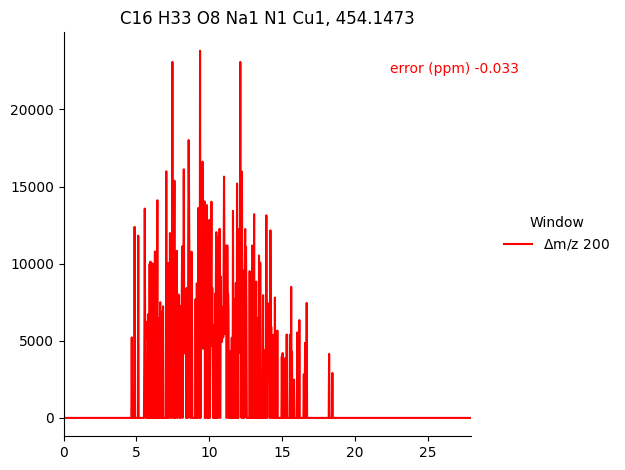

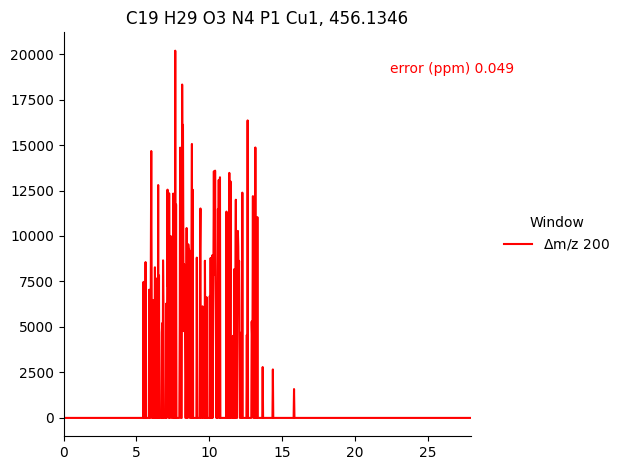

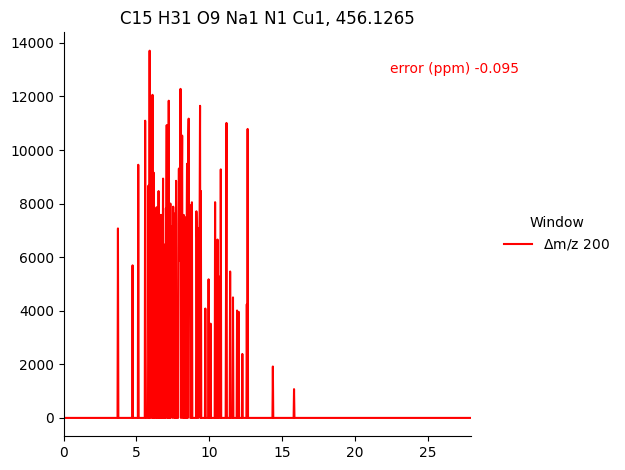

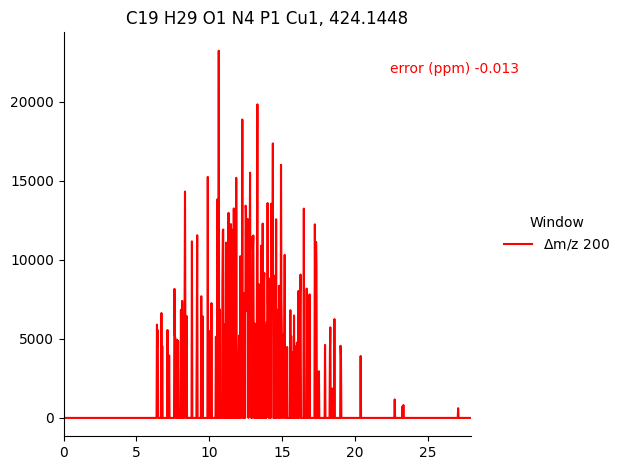

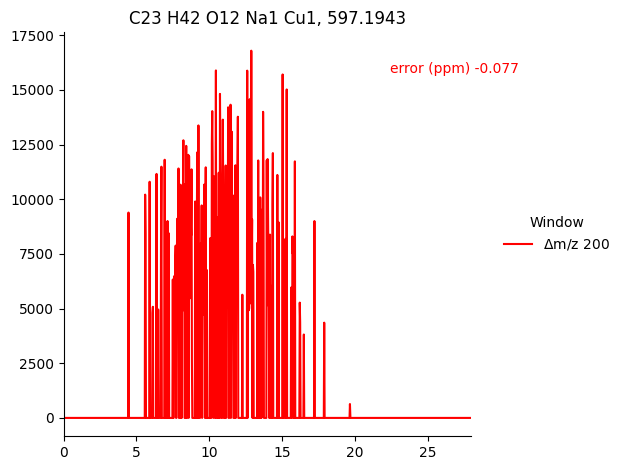

...

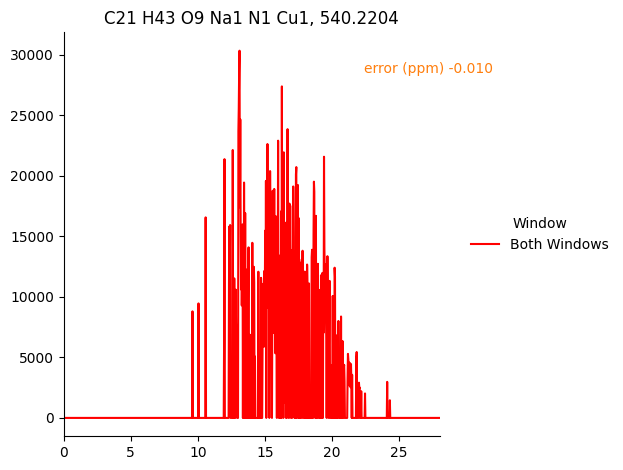

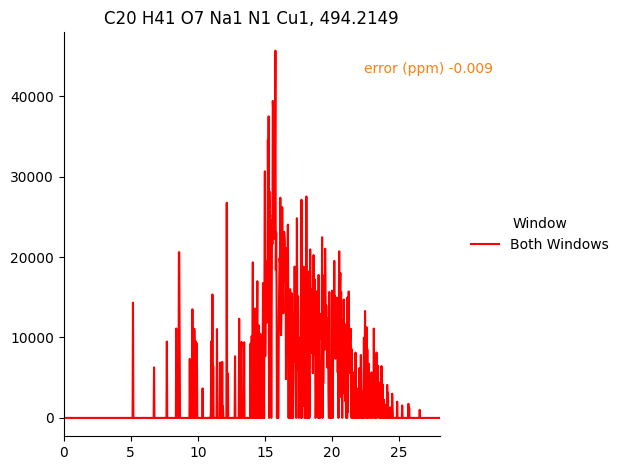

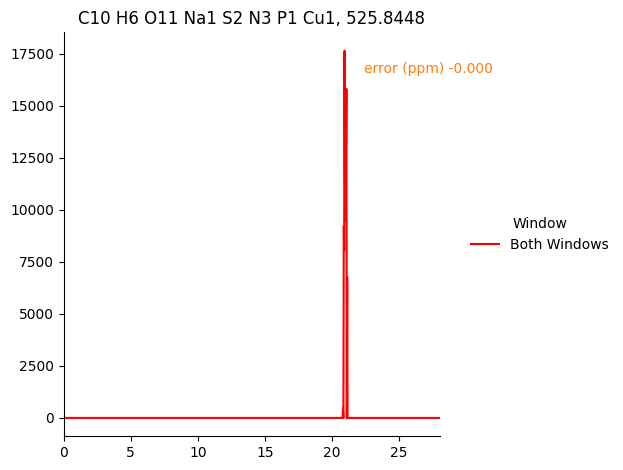

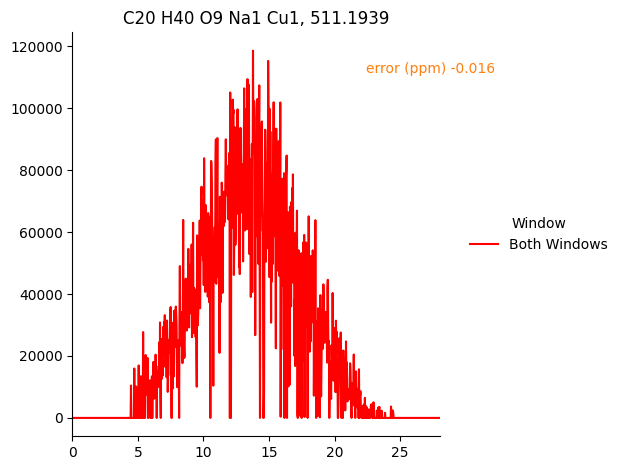

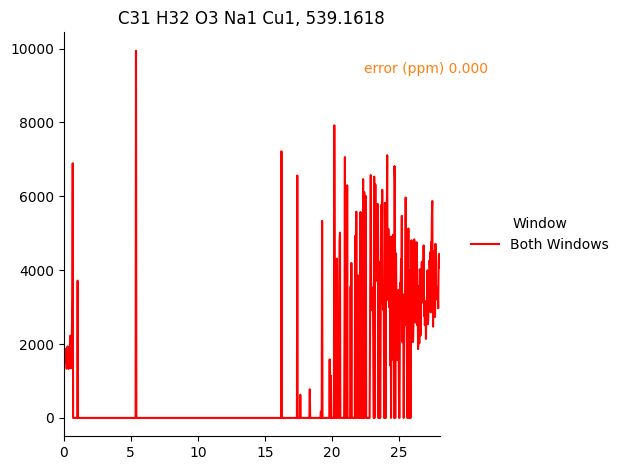

In [7]:
## MAKE Cu EICs pdf
pdf = PdfPages(svdir + '/eics/230222_spring-env_Cu_nrwonly_eics.pdf')

for mf in spring_cu_narrow_eics.keys():   
    key = list(spring_cu_narrow_eics[mf][0].keys())[0]
    eic = spring_cu_narrow_eics[mf][0][key]
    fig, ax = plt.subplots()
    
    eict=eic.time
    eics=eic.eic

    inds = np.where(np.asarray(eict)<28)

    eict = np.asarray(eict)[inds]
    eics = np.asarray(eics)[inds]

    ax.plot(eict, eics,color = 'red', label=r'$\Delta$m/z 200')
    mzerr_nrw = spring_cu_narrow[spring_cu_narrow['Molecular Formula']==mf]['m/z Error (ppm)'].values[0]
    ax.text(0.8,0.9,'error (ppm) %.3f' %mzerr_nrw, transform=ax.transAxes, color = 'red')

    ax.set_xlim(0,28)
    
    mzcal = spring_cu_narrow[spring_cu_narrow['Molecular Formula']==mf]['Calculated m/z'].values[0]

    ax.set_title(mf + ', %.4f'%mzcal)
    ax.legend(frameon = False,bbox_to_anchor=(1.05,0.5),title = 'Window',loc='center left')
    sns.despine()
    fig.tight_layout()
    pdf.savefig()

pdf.close()

pdf = PdfPages(svdir + '/eics/230222_spring-env_Cu_fullonly_eics.pdf')
for mf in spring_cu_full_eics.keys():   
    key = list(spring_cu_full_eics[mf][0].keys())[0]
    eic = spring_cu_full_eics[mf][0][key]
    fig, ax = plt.subplots()
    
    eict=eic.time
    eics=eic.eic

    inds = np.where(np.asarray(eict)<28)

    eict = np.asarray(eict)[inds]
    eics = np.asarray(eics)[inds]

    ax.plot(eict, eics,color = 'C0', label=r'$\Delta$m/z 1000')
    mzerr_full = spring_cu_full[spring_cu_full['Molecular Formula']==mf]['m/z Error (ppm)'].values[0]
    ax.text(0.8,0.9,'error (ppm) %.3f' %mzerr_full, transform=ax.transAxes, color = 'red')

    ax.set_xlim(0,28)
    
    mzcal = spring_cu_full[spring_cu_full['Molecular Formula']==mf]['Calculated m/z'].values[0]

    ax.set_title(mf + ', %.4f'%mzcal)
    ax.legend(frameon = False,bbox_to_anchor=(1.05,0.5),title = 'Window',loc='center left')
    sns.despine()
    fig.tight_layout()
    pdf.savefig()

pdf.close()

pdf = PdfPages(svdir + '/eics/230222_spring-env_Cu_both_eics.pdf')
for mf in spring_cu_both_eics.keys():   
    key = list(spring_cu_both_eics[mf][0].keys())[0]
    eic = spring_cu_both_eics[mf][0][key]
    fig, ax = plt.subplots()
    
    eict=eic.time
    eics=eic.eic

    inds = np.where(np.asarray(eict)<28)

    eict = np.asarray(eict)[inds]
    eics = np.asarray(eics)[inds]

    ax.plot(eict, eics,color = 'red', label=r'Both Windows')
    mzerr_both = spring_cu_both[spring_cu_both['Molecular Formula']==mf]['m/z Error (ppm)'].values[0]
    ax.text(0.8,0.9,'error (ppm) %.3f' %mzerr_both, transform=ax.transAxes, color = 'C1')

    ax.set_xlim(0,28)
    
    mzcal = spring_cu_both[spring_cu_both['Molecular Formula']==mf]['Calculated m/z'].values[0]

    ax.set_title(mf + ', %.4f'%mzcal)
    ax.legend(frameon = False,bbox_to_anchor=(1.05,0.5),title = 'Window',loc='center left')
    sns.despine()
    fig.tight_layout()
    pdf.savefig()
pdf.close()

In [ ]:
## GENERAL PLOTTING FUNCS
def vanKrevelen(df,ax,hcol,col,leg=False):
    pal = sns.set_palette(sns.color_palette('mako'), n_colors=len(df[hcol].unique()))
    if leg is False:
        if len(df['Peak Height'] > 0):
            ax = sns.scatterplot(data=df,x='O/C',y='H/C',size = (df['Peak Height']/max(df['Peak Height'])),hue = hcol,ax = ax,sizes=(20, 100),palette = pal, alpha = 0.5, legend=False) 
            ax.set_ylim(0.,3.)
            ax.set_xlim(0.,1.5)
    else:
        if len(df['Peak Height'] > 0):
            ax = sns.scatterplot(data=df,x='O/C',y='H/C',size = (df['Peak Height']/max(df['Peak Height'])),hue = hcol,ax = ax,sizes=(20, 100), palette = pal, alpha = 0.5) 
            ax.set_ylim(0.,3.)
            ax.set_xlim(0.,1.5)

def panelLabel(ax,lbl):
    ax.text(-.15, 1.1,lbl,
    horizontalalignment='center',
    verticalalignment='center',
    transform = ax.transAxes, fontweight='bold', fontsize = 10)

In [ ]:
## FLUORINE van Krevelen panels

def make_F_VKpanels(assignments):
    time = 10
    time2 = 16
    snthresh = 5
    snthresh_low = 0
    el = 'F'

    
    fig,((ax,ax4),(ax2,ax5),(ax3,ax6)) = plt.subplots(3,2,figsize = (6,8))

    features_in_all = assignments.features_in_both 
    features_in_all = features_in_all[(features_in_all['F']>0)] # & (features_in_all['S']<3) & (features_in_all['P']<1) & (features_in_all['N']<4)]
    features_in_all = features_in_all[(features_in_all['m/z Error (ppm)']<0.1) & (features_in_all['m/z Error (ppm)']>-0.1)]
    
    df = features_in_all[(features_in_all['Time']<time) & (features_in_all['S/N']<snthresh) & (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax,el,'C0')
    ax.set_title('<%s min.' %time, size = 10)

    df = features_in_all[(features_in_all['Time']<time2 ) & (features_in_all['Time']>time) & (features_in_all['S/N']<snthresh) & (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax2,el,'C0')
    ax2.set_title('Between %s and <%s min.' %(time,time2), size = 10)

    df = features_in_all[(features_in_all['Time']>time2 ) & (features_in_all['S/N']<snthresh)& (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax3,el,'C0')
    ax3.set_title('>%s min.' %time2, size = 10)


    dfm = assignments.features_in_narrow_only
    dfm = dfm[(dfm['F']>0)] # & (features_in_all['S']<3) & (features_in_all['P']<1) & (features_in_all['N']<4)]
    dfm = dfm[(dfm['m/z Error (ppm)']<0.1) & (dfm['m/z Error (ppm)']>-0.1)]

    df = dfm[(dfm['Time']<time) & (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax4,el,'C1')
    ax4.set_title('<%s min.' %time, size = 10)

    df = dfm[(dfm['Time']>time) & (dfm['Time']<time2)& (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax5,el,'C1')
    ax5.set_title('Between %s and <%s min.' %(time,time2), size = 10)

    df = dfm[(dfm['Time']>time2) & (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax6,el,'C1',leg=True)
    ax6.set_title('>%s min.' %time2, size = 10)
    h, l = ax6.get_legend_handles_labels()
    legend = ax6.legend()
    legend.remove()

    nEl = len(dfm[el].unique())+1
    L = fig.legend(h[1:nEl],l[1:nEl],title = 'F atoms',fontsize = 8, frameon = False, bbox_to_anchor = (0.98, 0.5), loc = 'center left')
    n = len(L.get_texts())
    for i in range(n):
        L.get_texts()[i].set_text(str(int(i+1)))


    plt.setp(L.get_title(),fontsize=10)

    axs = [ax, ax2, ax3, ax4, ax5, ax6]
    lbls = ['a','c','e','b','d','f']
    for ax, lbl in zip(axs,lbls):
        panelLabel(ax,lbl)

    fig.tight_layout()
    fig.text(0.3, 1.0,'Narrow & Full',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)

    fig.text(0.78, 1.0,'Narrow Only',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)


    sns.despine()
    #plt.show()
    nm = 'vanKrevelen_F_SN-0to5_' + assignments.dataset_name
    plt.savefig(svdir+nm+'.pdf', bbox_inches = 'tight')

In [ ]:
## IODINE van Krevelen panels

def make_I_VKpanels(assignments):
    time = 10
    time2 = 16
    snthresh = 5
    snthresh_low = 0
    el = 'I'

    
    fig,((ax,ax4),(ax2,ax5),(ax3,ax6)) = plt.subplots(3,2,figsize = (6,8))

    features_in_all = assignments.features_in_both 
    features_in_all = features_in_all[(features_in_all['I']>0)] # & (features_in_all['S']<3) & (features_in_all['P']<1) & (features_in_all['N']<4)]
    features_in_all = features_in_all[(features_in_all['m/z Error (ppm)']<0.1) & (features_in_all['m/z Error (ppm)']>-0.1)]
    
    df = features_in_all[(features_in_all['Time']<time) & (features_in_all['S/N']<snthresh) & (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax,el,'C0')
    ax.set_title('<%s min.' %time, size = 10)

    df = features_in_all[(features_in_all['Time']<time2 ) & (features_in_all['Time']>time) & (features_in_all['S/N']<snthresh) & (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax2,el,'C0')
    ax2.set_title('Between %s and <%s min.' %(time,time2), size = 10)

    df = features_in_all[(features_in_all['Time']>time2 ) & (features_in_all['S/N']<snthresh)& (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax3,el,'C0')
    ax3.set_title('>%s min.' %time2, size = 10)


    dfm = assignments.features_in_narrow_only
    dfm = dfm[(dfm['I']>0)] # & (features_in_all['S']<3) & (features_in_all['P']<1) & (features_in_all['N']<4)]
    dfm = dfm[(dfm['m/z Error (ppm)']<0.1) & (dfm['m/z Error (ppm)']>-0.1)]

    df = dfm[(dfm['Time']<time) & (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax4,el,'C1')
    ax4.set_title('<%s min.' %time, size = 10)

    df = dfm[(dfm['Time']>time) & (dfm['Time']<time2)& (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax5,el,'C1')
    ax5.set_title('Between %s and <%s min.' %(time,time2), size = 10)

    df = dfm[(dfm['Time']>time2) & (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax6,el,'C1',leg=True)
    ax6.set_title('>%s min.' %time2, size = 10)
    h, l = ax6.get_legend_handles_labels()
    legend = ax6.legend()
    legend.remove()

    nEl = len(dfm[el].unique())+1
    L = fig.legend(h[1:nEl],l[1:nEl],title = 'I atoms',fontsize = 8, frameon = False, bbox_to_anchor = (0.98, 0.5), loc = 'center left')
    n = len(L.get_texts())
    for i in range(n):
        L.get_texts()[i].set_text(str(int(i+1)))


    plt.setp(L.get_title(),fontsize=10)

    axs = [ax, ax2, ax3, ax4, ax5, ax6]
    lbls = ['a','c','e','b','d','f']
    for ax, lbl in zip(axs,lbls):
        panelLabel(ax,lbl)

    fig.tight_layout()
    fig.text(0.3, 1.0,'Narrow & Full',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)

    fig.text(0.78, 1.0,'Narrow Only',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)


    sns.despine()
    #plt.show()
    nm = 'vanKrevelen_I_SN-0to5_' + assignments.dataset_name
    plt.savefig(svdir+nm+'.pdf', bbox_inches = 'tight')

In [ ]:
## SULFUR van Krevelen panels

def make_S_VKpanels(assignments):
    time = 10
    time2 = 16
    snthresh = 5
    snthresh_low = 0
    el = 'S'

    
    fig,((ax,ax4),(ax2,ax5),(ax3,ax6)) = plt.subplots(3,2,figsize = (6,8))

    features_in_all = assignments.features_in_both 
    features_in_all = features_in_all[(features_in_all['S']>0)] # & (features_in_all['S']<3) & (features_in_all['P']<1) & (features_in_all['N']<4)]
    features_in_all = features_in_all[(features_in_all['m/z Error (ppm)']<0.1) & (features_in_all['m/z Error (ppm)']>-0.1)]
    
    df = features_in_all[(features_in_all['Time']<time) & (features_in_all['S/N']<snthresh) & (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax,el,'C0')
    ax.set_title('<%s min.' %time, size = 10)

    df = features_in_all[(features_in_all['Time']<time2 ) & (features_in_all['Time']>time) & (features_in_all['S/N']<snthresh) & (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax2,el,'C0')
    ax2.set_title('Between %s and <%s min.' %(time,time2), size = 10)

    df = features_in_all[(features_in_all['Time']>time2 ) & (features_in_all['S/N']<snthresh)& (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax3,el,'C0')
    ax3.set_title('>%s min.' %time2, size = 10)


    dfm = assignments.features_in_narrow_only
    dfm = dfm[(dfm['S']>0)] # & (features_in_all['S']<3) & (features_in_all['P']<1) & (features_in_all['N']<4)]
    dfm = dfm[(dfm['m/z Error (ppm)']<0.1) & (dfm['m/z Error (ppm)']>-0.1)]

    df = dfm[(dfm['Time']<time) & (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax4,el,'C1')
    ax4.set_title('<%s min.' %time, size = 10)

    df = dfm[(dfm['Time']>time) & (dfm['Time']<time2)& (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax5,el,'C1')
    ax5.set_title('Between %s and <%s min.' %(time,time2), size = 10)

    df = dfm[(dfm['Time']>time2) & (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax6,el,'C1',leg=True)
    ax6.set_title('>%s min.' %time2, size = 10)
    h, l = ax6.get_legend_handles_labels()
    legend = ax6.legend()
    legend.remove()

    nEl = len(dfm[el].unique())+1
    L = fig.legend(h[1:nEl],l[1:nEl],title = 'S atoms',fontsize = 8, frameon = False, bbox_to_anchor = (0.98, 0.5), loc = 'center left')
    n = len(L.get_texts())
    for i in range(n):
        L.get_texts()[i].set_text(str(int(i+1)))


    plt.setp(L.get_title(),fontsize=10)

    axs = [ax, ax2, ax3, ax4, ax5, ax6]
    lbls = ['a','c','e','b','d','f']
    for ax, lbl in zip(axs,lbls):
        panelLabel(ax,lbl)

    fig.tight_layout()
    fig.text(0.3, 1.0,'Narrow & Full',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)

    fig.text(0.78, 1.0,'Narrow Only',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)


    sns.despine()
    #plt.show()
    nm = 'vanKrevelen_S_SN-0to5_' + assignments.dataset_name
    plt.savefig(svdir+nm+'.pdf', bbox_inches = 'tight')

In [ ]:
## COPPER van Krevelen panels

def make_Cu_VKpanels(assignments):
    time = 10
    time2 = 16
    snthresh = 5
    snthresh_low = 0
    el = 'N'

    
    fig,((ax,ax4),(ax2,ax5),(ax3,ax6)) = plt.subplots(3,2,figsize = (5,7))

    features_in_all = assignments.features_in_both 
    features_in_all = features_in_all[(features_in_all['Cu']>0)] # & (features_in_all['S']<3) & (features_in_all['P']<1) & (features_in_all['N']<4)]
    #features_in_all = features_in_all[(features_in_all['m/z Error (ppm)']<0.1) & (features_in_all['m/z Error (ppm)']>-0.1)]

    
    df = features_in_all[(features_in_all['Time']<time) & (features_in_all['S/N']<snthresh) & (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax,el,'C0')
    ax.set_title('<%s min' %time, size = 10)

    df = features_in_all[(features_in_all['Time']<time2 ) & (features_in_all['Time']>time) & (features_in_all['S/N']<snthresh) & (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax2,el,'C0')
    ax2.set_title('%s-%s min' %(time,time2), size = 10)

    df = features_in_all[(features_in_all['Time']>time2 ) & (features_in_all['S/N']<snthresh)& (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax3,el,'C0')
    ax3.set_title('>%s min' %time2, size = 10)


    dfm = assignments.features_in_narrow_only
    dfm = dfm[(dfm['Cu']>0)] # & (features_in_all['S']<3) & (features_in_all['P']<1) & (features_in_all['N']<4)]
    #dfm = dfm[(dfm['m/z Error (ppm)']<0.1) & (dfm['m/z Error (ppm)']>-0.1)]

    df = dfm[(dfm['Time']<time) & (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax4,el,'C1')
    ax4.set_title('<%s min' %time, size = 10)

    df = dfm[(dfm['Time']>time) & (dfm['Time']<time2)& (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax5,el,'C1')
    ax5.set_title('%s-%s min' %(time,time2), size = 10)

    df = dfm[(dfm['Time']>time2) & (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax6,el,'C1',leg=True)
    ax6.set_title('>%s min' %time2, size = 10)
    h, l = ax6.get_legend_handles_labels()
    legend = ax6.legend()
    legend.remove()

    nEl = len(dfm[el].unique())
    L = fig.legend(h[1:nEl+1],l[1:nEl+1],title = 'N atoms',fontsize = 8, frameon = False, bbox_to_anchor = (0.98, 0.5), loc = 'center left')
    n = len(L.get_texts())
    for i in range(n):
        L.get_texts()[i].set_text(str(int(i)))

    plt.setp(L.get_title(),fontsize=10)

    axs = [ax, ax2, ax3, ax4, ax5, ax6]
    lbls = ['a','c','e','b','d','f']
    for ax, lbl in zip(axs,lbls):
        panelLabel(ax,lbl)

    fig.tight_layout()
    fig.text(0.3, 1.0,'Narrow & Full',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)

    fig.text(0.78, 1.0,'Narrow Only',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)


    sns.despine()
    #plt.show()
    nm = 'vanKrevelen_Cu_N_SN-0to5_' + assignments.dataset_name
    plt.savefig(svdir+nm+'.pdf', bbox_inches = 'tight')

In [ ]:
## NITROGEN van Krevelen panels

def make_N_VKpanels(assignments):
    time = 10
    time2 = 16
    snthresh = 5
    snthresh_low = 0
    el = 'N'

    
    fig,((ax,ax4),(ax2,ax5),(ax3,ax6)) = plt.subplots(3,2,figsize = (6,8))

    features_in_all = assignments.features_in_both 
    features_in_all = features_in_all[(features_in_all['N']>0)] # & (features_in_all['S']<3) & (features_in_all['P']<1) & (features_in_all['N']<4)]
    features_in_all = features_in_all[(features_in_all['m/z Error (ppm)']<0.1) & (features_in_all['m/z Error (ppm)']>-0.1)]
    
    df = features_in_all[(features_in_all['Time']<time) & (features_in_all['S/N']<snthresh) & (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax,el,'C0')
    ax.set_title('<%s min.' %time, size = 10)

    df = features_in_all[(features_in_all['Time']<time2 ) & (features_in_all['Time']>time) & (features_in_all['S/N']<snthresh) & (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax2,el,'C0')
    ax2.set_title('Between %s and <%s min.' %(time,time2), size = 10)

    df = features_in_all[(features_in_all['Time']>time2 ) & (features_in_all['S/N']<snthresh)& (features_in_all['S/N']>snthresh_low)]
    vanKrevelen(df,ax3,el,'C0')
    ax3.set_title('>%s min.' %time2, size = 10)


    dfm = assignments.features_in_narrow_only
    dfm = dfm[(dfm['N']>0)] # & (features_in_all['S']<3) & (features_in_all['P']<1) & (features_in_all['N']<4)]
    dfm = dfm[(dfm['m/z Error (ppm)']<0.1) & (dfm['m/z Error (ppm)']>-0.1)]


    
    df = dfm[(dfm['Time']>time) & (dfm['Time']<time2)& (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax5,el,'C1')
    ax5.set_title('Between %s and <%s min.' %(time,time2), size = 10)

    df = dfm[(dfm['Time']>time2) & (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax6,el,'C1')
    ax6.set_title('>%s min.' %time2, size = 10)
    
    df = dfm[(dfm['Time']<time) & (dfm['S/N']<snthresh)& (dfm['S/N']>snthresh_low)]
    vanKrevelen(df,ax4,el,'C1',leg=True)
    ax4.set_title('<%s min.' %time, size = 10)
    h, l = ax4.get_legend_handles_labels()
    legend = ax4.legend()
    legend.remove()

    nEl = len(dfm[el].unique())
    
    L = fig.legend(h[1:nEl+1],l[1:nEl+1],title = 'N atoms',fontsize = 8, frameon = False, bbox_to_anchor = (0.98, 0.5), loc = 'center left')
    n = len(L.get_texts())
    for i in range(n):
        L.get_texts()[i].set_text(str(int(i+1)))



    plt.setp(L.get_title(),fontsize=10)

    axs = [ax, ax2, ax3, ax4, ax5, ax6]
    lbls = ['a','c','e','b','d','f']
    for ax, lbl in zip(axs,lbls):
        panelLabel(ax,lbl)

    fig.tight_layout()
    fig.text(0.3, 1.0,'Narrow & Full',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)

    fig.text(0.78, 1.0,'Narrow Only',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)


    sns.despine()
    #plt.show()
    nm = 'vanKrevelen_N_SN-0to5_' + assignments.dataset_name
    plt.savefig(svdir+nm+'.pdf', bbox_inches = 'tight')

In [16]:
## KDE error plots for specific element
def plotErrorKde_el(ax, data_df,window,element1,element2,max1=50, min2=1,max2=100):
    # window options: narrow, full, both

    df_cu_full = data_df.features_in_both[(data_df.features_in_both['Cu']>0) & (data_df.features_in_both['Window Size (m/z)']=='1000')]

    df_cu_narrow = pd.concat([data_df.features_in_both[(data_df.features_in_both['Cu']>0) & (data_df.features_in_both['Window Size (m/z)']=='200')], data_df.features_in_narrow_only[data_df.features_in_narrow_only['Cu']>0]])

    unique_200mz = df_cu_narrow
    unique_200mz = unique_200mz[(unique_200mz[element1]>0) & (unique_200mz[element1]<=max1) & (unique_200mz[element2]<=max2) & (unique_200mz[element2]>=min2)]
    unique_fullmz_range = df_cu_full
    unique_fullmz_range = unique_fullmz_range[(unique_fullmz_range[element1]>0) & (unique_fullmz_range[element1]<=max1) & (unique_fullmz_range[element2]>=min2) & (unique_fullmz_range[element2]<=max2)]
    #unique_fullmz_range = df_cu_full[df_cu_full[element2]==4]


    column = 'm/z Error (ppm)'  ## title for main plot

    #fig, (ax,ax1) = plt.subplots(2,1, figsize = (5,6))

    if window == 'narrow':
        df = unique_200mz
    elif window == 'full':
        df = unique_fullmz_range
    elif window == 'both':
        df = pd.concat([unique_200mz, unique_fullmz_range])

    pal = sns.color_palette('colorblind')

    df.sort_values(by=['mol_class'],inplace=True)
    '''if window != 'full':
        ax = sns.kdeplot(data=df, x=column, ax = ax, hue = element2, palette = pal, legend=True)
    else:
        ax = sns.kdeplot(data=df[df['N']==1], x=column, ax = ax, color=pal[0],  legend=True)
        ax = sns.kdeplot(data=df[df['N']==2], x=column, ax = ax, color=pal[1],  legend=True)
        ax = sns.kdeplot(data=df[df['N']==4], x=column, ax = ax, color=pal[3],  legend=True)'''
        
    ax = sns.kdeplot(data=df, x=column, ax = ax, hue = element2, palette = pal, legend=True)
    ax.set_xlim(-.4,.4)
    
    return ax 



In [17]:
## KDE error plots
def plotErrorKde(data_df,dataset_name,windows):
    # window options: narrow, full, both
    
    df_full = data_df.fullscan

    df_narrow = data_df.narrowscan

    unique_200mz = df_narrow
    #unique_200mz = unique_200mz[(unique_200mz[element1]>0) & (unique_200mz[element1]<=max1) & (unique_200mz[element2]<=max2) & (unique_200mz[element2]>=min2)]
    unique_fullmz_range = df_full
    #unique_fullmz_range = unique_fullmz_range[(unique_fullmz_range[element1]>0) & (unique_fullmz_range[element1]<=max1) & (unique_fullmz_range[element2]>=min2) & (unique_fullmz_range[element2]<=max2)]
    #unique_fullmz_range = df_cu_full[df_cu_full[element2]==4]

    column = 'm/z Error (ppm)'  ## title for main plot

    fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2, figsize = (5,5))

    for window in windows:

        if window == 'narrow':
            df = unique_200mz
            ax = ax1
            makeleg = False

        elif window == 'full':
            df = unique_fullmz_range
            ax = ax2
            makeleg = True

        '''df1 = df[(df['mol_class'] =='CHO') | (df['mol_class'] =='CHON') ]
    
        df = df1
        df.sort_values(by=['mol_class'],inplace=True)
        
        pal = sns.color_palette('dark')
        
        if makeleg:

            sns.kdeplot(data=df, x=column, hue=hue_col, ax = ax,palette=pal, legend=True)
    
            legend = ax.get_legend()
            handles = legend.legendHandles
            labels = df['mol_class'].unique()
            
            leg = ax.legend(handles,labels,  bbox_to_anchor=(1.2, 0.5), loc='center right',frameon=False, borderaxespad=0, title = 'Mol. Class', prop={'size': 8})
        
        else:

            sns.kdeplot(data=df, x=column, hue=hue_col, ax = ax,palette=pal, legend=False)'''

        df1 = df[df['Cu']>0]
        print('%s Cu assignments' %len(df1))
        df2 = df1[df1['S']>=1]
        df2['hetero'] = 'S'
        print('%s Cu assignments with S' %len(df1[df1['S']>=1]))
        print('%s Cu assignments with S' %len(df2))
        df3 = df1[(df1['P']>=1) ]
        df3['hetero'] = 'P'
        print('%s Cu assignments wit P' %len(df1[df1['P']>=1]))
        print('%s Cu assignments wit P' %len(df3))
        df4 = df1[(df1['N']>=1) ]
        df4['hetero'] = 'N'
        print('%s Cu assignments with N' %len(df1[df1['N']>=1]))
        print('%s Cu assignments with N' %len(df4))
        df5 = df1[df1['Na']>=1]
        df5['hetero'] = 'Na'
        print('%s Cu assignments with Na\n' %len(df1[df1['Na']>=1]))
        print('%s Cu assignments with N' %len(df5))



        dd = pd.concat([ df5, df3, df4, df2])
        
        temp = df.copy()
        temp2 = temp[(temp['Cu'] >=1) ]
        temp2['mol_class'] = 'Contains Cu'

        if makeleg:

            sns.kdeplot(data=dd, x = 'm/z Error (ppm)', palette = sns.color_palette('colorblind'),ax=ax, hue='hetero', legend=True)

            legend = ax.get_legend()
            handles = legend.legendHandles
            labels = dd['hetero'].unique()
            
            leg = ax.legend(handles,labels,  bbox_to_anchor=(1.2, 0.5), loc='center right',frameon=False, borderaxespad=0, title = 'Cu m.f.\nwith:', prop={'size': 8})
            ax.add_artist(leg)
            sns.kdeplot(data=temp2, x=column,color = 'darkgray', ax = ax,label='All m.f. with Cu', legend = True)
            from matplotlib.lines import Line2D
            line = Line2D([0], [0], label='All m.f. with Cu', color='darkgray')
            handles = []
            handles.extend([line])
            labels = [None]
            leg2 = ax.legend(handles, labels, loc='center right', bbox_to_anchor=(1.2, 0.9), 
                              frameon = False, title='All m.f.\nwith Cu', prop={'size': 8}) 

        else:

            sns.kdeplot(data=dd, x = 'm/z Error (ppm)', palette = sns.color_palette('colorblind'),ax=ax, hue='hetero', legend=False)

            sns.kdeplot(data=temp2, x=column,color = 'darkgray', ax = ax,label='All m.f. with Cu', legend = False)

            '''legend1 = ax.get_legend()
            legend1.remove()'''
        
        ax.set_xlim(-.4,.4)




        if window == 'narrow':
            df  = unique_200mz[(unique_200mz['Cu']>0) & (unique_200mz['Cu']<=1) & (unique_200mz['N']<=4) & (unique_200mz['N']>=1)]
            ax = ax3
        elif window == 'full':
            df = unique_fullmz_range[(unique_fullmz_range['Cu']>0) & (unique_fullmz_range['Cu']<=1) & (unique_fullmz_range['N']>=1)
                                                            & (unique_fullmz_range['N']<=4)]
            ax = ax4
        pal = sns.color_palette('colorblind')

        sns.kdeplot(data=df, x=column,hue = 'N',palette=pal,  ax = ax, legend = True)

        '''temp = df.copy()
        temp2 = temp[(temp['Cu'] >=1) ]
        temp2['mol_class'] = 'Contains Cu'
'''
        if makeleg:

            sns.kdeplot(data=df, x=column,hue = 'N',palette=pal,  ax = ax, legend = True)

            temp = df.copy()
            temp2 = temp[(temp['Cu'] >=1) ]
            temp2['mol_class'] = 'Contains Cu'
            
            legend1 = ax.get_legend()
            handles = legend1.legendHandles
            labels = [str(int(i)) for i in range(1,5)]
            leg1 = ax.legend(handles,labels, bbox_to_anchor=(1.2, 0.4), loc='center right',frameon=False, borderaxespad=0, title = 'N atoms', prop={'size': 8})
            ax.add_artist(leg1)

            '''sns.kdeplot(data=temp2, x=column,color = 'darkgray', ax = ax,label='All m.f. with Cu', legend = True)
            
            from matplotlib.lines import Line2D
            line = Line2D([0], [0], label='All m.f. with Cu', color='darkgray')
            handles = []
            handles.extend([line])
            labels = [None]
            plt.legend(handles, labels, loc='center right', bbox_to_anchor=(1.2, 0.8), 
                       frameon = False, title='All m.f.\nwith Cu', prop={'size': 8}) #.legend(handles = [circ1,circ2,circ3],loc=2)#.'''

        else:
            sns.kdeplot(data=df, x=column,hue = 'N',palette=pal,  ax = ax, legend = False)

            '''temp = df.copy()
            temp2 = temp[(temp['Cu'] >=1) ]
            temp2['mol_class'] = 'Contains Cu'''
            
            '''sns.kdeplot(data=temp2, x=column,color = 'darkgray', ax = ax,label='All m.f. with Cu', legend = False)'''

            legend1 = ax.get_legend()
            legend1.remove()

        ax.set_xlim(-.4,.4)
        sns.despine()

    lbla = ax1.text(-0.15, 1.05,'a',
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax1.transAxes, fontweight='bold', fontsize = 10)
    
    lblb = ax2.text(-0.15, 1.05,'b',
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax2.transAxes, fontweight='bold', fontsize = 10)
    
    lblc = ax3.text(-0.15, 1.05,'c',
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax3.transAxes, fontweight='bold', fontsize = 10)
    
    lbld = ax4.text(-0.15, 1.05,'d',
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax4.transAxes, fontweight='bold', fontsize = 10)

    title_nr = fig.text(0.3, 1.0,'200 m/z Window',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)

    title_wd = fig.text(0.78, 1.0,'1000 m/z Window',
        horizontalalignment='center',
        verticalalignment='center', fontsize = 12)
    
    fig.tight_layout()
    sns.despine()
    plt.savefig(svdir + 'kde_assign_'+ dataset_name +'.pdf', bbox_extra_artists=(title_nr, title_wd, lblb,lbla,lblc,lbld, leg, leg1, leg2),bbox_inches='tight')


In [ ]:
## m/z v. assignment error plots 
def plotMzVError(results,element1, element2):
    import itertools
    # set palette 
    #itertools.cycle(pallete)
    

    fig, (ax1, ax3) = plt.subplots(2, 1, figsize = (6,4))

    itertools.cycle(sns.color_palette())
    df = results.features_in_both
    ax1 =sns.scatterplot(data=df[(df['mol_class']!='Unassigned') & (df[element1]>0)], x="m/z", y="m/z Error (ppm)",alpha = 0.5, hue=element1,  ax = ax1)
    ax1.legend(frameon = False, bbox_to_anchor= (1.0,0.5), loc = 'center left')
    L = ax1.legend(frameon = False,title = element1+' atoms', bbox_to_anchor= (1.0,0.5), loc = 'center left')
    n = len(L.get_texts())
    for i in range(n):
        L.get_texts()[i].set_text(str(int(i+1)))

    itertools.cycle(sns.color_palette('mako'))
    df = results.features_in_both
    ax3 =sns.scatterplot(data=df[(df['mol_class']!='Unassigned') & (df[element2]>0)], x="m/z", y="m/z Error (ppm)",alpha = 0.5,hue=element2,palette = sns.color_palette('colorblind'), ax = ax3)
    L = ax3.legend(frameon = False,title = element2+' atoms', bbox_to_anchor= (1.0,0.5), loc = 'center left')
    n = len(L.get_texts())
    for i in range(n):
        L.get_texts()[i].set_text(str(int(i+1)))

    fig.tight_layout()
    axs = [ax1, ax3]
    lbls = ['a','b']
    for ax, lbl in zip(axs,lbls):
        panelLabel(ax,lbl)
    plt.savefig(svdir+'mz_v_error_both_windows_'+results.dataset_name+'_'+element1+'_'+element2+'.pdf', bbox_inches = 'tight')


    fig, (ax2,ax4) = plt.subplots(2, 1, figsize = (6,4))

    itertools.cycle(sns.color_palette())
    df = results.features_in_narrow_only
    ax2 =sns.scatterplot(data=df[(df['mol_class']!='Unassigned') & (df[element1]>0)], x="m/z", y="m/z Error (ppm)",alpha = 0.5,hue=element1,ax = ax2)
    ax2.legend(frameon = False, bbox_to_anchor= (1.0,0.5), loc = 'center left')
    L = ax2.legend(frameon = False,title = element1+' atoms', bbox_to_anchor= (1.0,0.5), loc = 'center left')
    n = len(L.get_texts())
    for i in range(n):
        L.get_texts()[i].set_text(str(int(i+1)))

    itertools.cycle(sns.color_palette('mako'))
    df = df = results.features_in_narrow_only
    ax4 =sns.scatterplot(data=df[(df['mol_class']!='Unassigned') & (df[element2]>0)], x="m/z", y="m/z Error (ppm)",alpha = 0.5,hue=element2,palette = sns.color_palette('colorblind'), ax = ax4)
    L = ax4.legend(frameon = False,title = element2+' atoms', bbox_to_anchor= (1.0,0.5), loc = 'center left')
    n = len(L.get_texts())
    for i in range(n):
        L.get_texts()[i].set_text(str(int(i+1)))

    axs = [ax2, ax4]
    lbls = ['a','b']
    for ax, lbl in zip(axs,lbls):
        panelLabel(ax,lbl)


    fig.tight_layout()
    plt.savefig(svdir+'mz_v_error_narrow_window_'+results.dataset_name+'_'+element1+'_'+element2+'.pdf', bbox_inches = 'tight')


In [87]:
## Figure 1: (a) Total detected features; (b) Assignments along separation 

def makeFig1(assignments,dataset_name, xlims):
    import matplotlib.gridspec as gridspec
    import matplotlib.patches as mpatches

    plt.rcParams['xtick.labelsize'] = 8
    plt.rcParams['ytick.labelsize'] = 8
    #combo2 = assignments.combo_all

    combo2 = assignments.combo_bs
    import matplotlib as mpl
   
    xmin = xlims[0]
    xmax = xlims[1]

    fig, (ax2,ax4) = plt.subplots(nrows=2, ncols=1, figsize = (6,4))
    plt.subplots_adjust(hspace=0.3)
    #make outer gridspec
    outer = gridspec.GridSpec(2, 1, height_ratios = [1, 1]) 
    #make nested gridspecs
    gs2 = gridspec.GridSpecFromSubplotSpec(1, 1, subplot_spec = outer[1])
    gs1 = gridspec.GridSpecFromSubplotSpec(1, 1, subplot_spec = outer[0])

    plt.rcParams['legend.title_fontsize'] = 8

    ax2 = plt.subplot(gs2[0])
    
    sns.histplot(combo2, x="m/z", hue="Window Size (m/z)", multiple="dodge",palette=['C2', 'peru'],alpha =0.6, ax=ax2, binwidth=10, shrink = 0.9, edgecolor="white")

    ax2.set_ylabel('Count ($10^3$)')

    ax2.set_xlim(xmin,xmax)
    major_tick_locs = range(xmin,xmax,20)
    minor_tick_locs = range(xmin,xmax,10)
    ax2.set_xticks(major_tick_locs, minor=False)
    ax2.set_xticks(minor_tick_locs, minor=True)
    legend = ax2.get_legend()
    handles = legend.legendHandles
    labels = ['200 m/z','1000 m/z']
    ax2.set_title('Unique Features', fontsize = 10)

    # after plotting the data, format the labels
    current_values = plt.gca().get_yticks()
    plt.gca().set_yticklabels(['%.0f' %(x/1000) for x in current_values])
    fig = plt.gcf()

    ax2.legend(handles, labels, bbox_to_anchor=(1.02, 0.7), loc='center left',frameon=False, borderaxespad=0, title = 'Window Size', prop={'size': 8})
    lblb = ax2.text(-0.15, 1.05,'b',
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax2.transAxes, fontweight='bold', fontsize = 10)

    ax4 = plt.subplot(gs1[0])

    mz200 = assignments.mz200
    mzfull = assignments.mzfull
    all_results1 = pd.concat([mzfull[(mzfull['m/z']>=xmin) & (mzfull['m/z']<=xmax)],mz200[(mz200['m/z']>=xmin) & (mz200['m/z']<=xmax)]], ignore_index=True)

    allresults_list =[]
    for molclass in all_results1['mol_class'].unique():
        if (molclass != 'CHO') and (molclass != 'CHON') and (molclass != 'Unassigned'):
            temp = all_results1[all_results1['mol_class']==molclass].copy()
            temp['mol_class'] = 'Other'
        else:
            temp = all_results1[all_results1['mol_class']==molclass].copy()
        allresults_list.append(temp)
    all_results = pd.concat(allresults_list, ignore_index=True)

    assign_summary=[]
    for time in all_results['Time'].unique():    
        for w in all_results['Window Size (m/z)'].unique():
            current={}
            current['Time']=time
            current['m/z Window'] = w
            for mol_class in all_results['mol_class'].unique(): #['CHO','CHON', 'Unassigned']:
                current[mol_class]=len(all_results[(all_results['mol_class']==mol_class) & (all_results['Time']==time) & (all_results['Window Size (m/z)']==w)])
            assign_summary.append(current)
    df=pd.DataFrame(assign_summary)

    ax4 = df.plot.bar(x='Time',y=df.columns[1:],stacked=True,ylabel='Peaks',ax=ax4, color=['C0','C1','C2','firebrick'], alpha=0.8)
    plt.rcParams['hatch.linewidth'] = 4
    n = 20
    for i in range(n):
        new_x = ax4.patches[i].get_x() - ((i%2)/2)
        ax4.patches[i].set_x(new_x)
        ax4.patches[i+n].set_x(new_x)
        ax4.patches[i+(2*n)].set_x(new_x)

        if (i%2)/2 > 0:
            ax4.patches[i].set_x(new_x+0.1)
            ax4.patches[i+n].set_x(new_x+0.1)
            ax4.patches[i+(2*n)].set_x(new_x+0.1)
            ax4.patches[i+(3*n)].set_x(new_x+0.1)

            ax4.patches[i].set_hatch('///')
            ax4.patches[i].set_edgecolor('C0')
            ax4.patches[i].set_fill(None)
            #ax4.patches[i].set_alpha(0.7)
            ax4.patches[i+n].set_hatch('///')
            ax4.patches[i+n].set_edgecolor('C1')
            ax4.patches[i+n].set_fill(None)
            ax4.patches[i+(2*n)].set_alpha(0.8)
            ax4.patches[i+(2*n)].set_hatch('///')
            ax4.patches[i+(2*n)].set_edgecolor('C2')
            ax4.patches[i+(2*n)].set_fill(None)
            ax4.patches[i+(3*n)].set_alpha(0.8)
            ax4.patches[i+(3*n)].set_hatch('///')
            ax4.patches[i+(3*n)].set_edgecolor('firebrick')
            ax4.patches[i+(3*n)].set_fill(None)
    major_tick_locs = np.array([x.get_x()+1/4 for x in ax4.patches[:20]]).reshape(10, 2).mean(axis=1)
    ax4.set_xticks(major_tick_locs)

    major_tick_labels = df['Time'].unique()
    ax4.xaxis.set_ticklabels(major_tick_labels)

    current_values = plt.gca().get_yticks()
    plt.gca().set_yticklabels(['%.0f' %(x/1000) for x in current_values])
    ax4.tick_params(axis='x', which='major', pad=5, rotation=0)

    ax4.set_xlabel('Time (min)')
    ax4.set_ylabel('Count ($10^3$)')

    ax4.legend(loc='upper left', bbox_to_anchor=(1.0,1.3), frameon=False, title='Mol. Class')

    leg = plt.legend(loc='upper left', bbox_to_anchor=(1., 1.0), frameon=False, title='Mol. Class', prop={'size': 8})
    ax4.add_artist(leg)
    ax4.set_title('Assignments across Separation',fontsize= 10)
    a_val = 0.6

    patch_full = mpatches.Patch(color='gray', alpha=a_val,label='1000 m/z')
    patch_200 = mpatches.Patch(edgecolor='gray',  alpha=a_val, facecolor = 'white', hatch = '///',label='200 m/z')

    plt.legend(handles=[patch_200,patch_full], loc='upper left', bbox_to_anchor=(1.0, 0.3), frameon = False, title='Window Size', prop={'size': 8}) #.legend(handles = [circ1,circ2,circ3],loc=2)#.
    sns.despine()
    lbla = ax4.text(-.15, 1.05,'a',
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax4.transAxes, fontweight='bold', fontsize = 10)
    fig = plt.gcf()

    fig.tight_layout(pad = 1)
    plt.savefig(svdir + 'peaks_hist,sep_'+dataset_name+'.pdf', bbox_extra_artists=(leg,lblb,lbla), bbox_inches='tight')

In [ ]:
#### WASTEWATER
#### LOAD PROCESSED DATA SET FOR FIGURES 
data_dir = drive_dir + 'assignments/wastewater-final-eff/CHONSP_etc/'
data_df = pd.read_csv(data_dir+'p230216_wastewater-final-eff_neg_21TNHMFL-Jan_002.csv'  ) 
data_df['Window Size (m/z)'] = data_df['Window Size (m/z)'].map(str)

wastewater_asgn = Assignments(data_df,mzrange = [300,500], dataset_name='wastewater-final-eff')

In [ ]:
## make figure 1
makeFig1(spring_asgn,dataset_name='spring_env',xlims=[400,600])

#makeFig1(wastewater_asgn,dataset_name='wastewater-final-eff',xlims=[300,500])

401 Cu assignments
48 Cu assignments with S
48 Cu assignments with S
146 Cu assignments wit P
146 Cu assignments wit P
262 Cu assignments with N
262 Cu assignments with N
257 Cu assignments with Na

257 Cu assignments with N
400 Cu assignments
32 Cu assignments with S
32 Cu assignments with S
194 Cu assignments wit P
194 Cu assignments wit P
267 Cu assignments with N
267 Cu assignments with N
181 Cu assignments with Na

181 Cu assignments with N


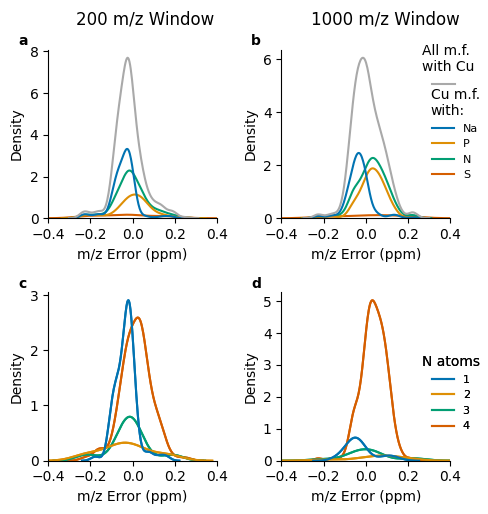

In [20]:
### make KDE error plots
windows = ['narrow', 'full']

plotErrorKde(spring_asgn,dataset_name = 'spring_env', windows = windows)

    #plotErrorKde(wastewater_asgn,dataset_name = 'wastewater-final-eff', window = window)

In [5]:
# get assign stats
data_df = spring_asgn
el = 'N'
df_both = data_df.features_in_both
df_full = pd.concat([data_df.features_in_full_only, df_both[df_both['Window Size (m/z)'] == '1000']])
df_full = df_full[df_full['Cu']>0]
df = df_full[df_full[el]>0]
print('Full window')
print('%s features with Cu' %(len(df_full)))
print('%s features with Cu & any %s' %(len(df),el))
df = df_full[df_full[el]==1]
print('%s features with Cu & 1 %s' %(len(df),el))
df = df_full[df_full[el]==2]
print('%s features with Cu & 2 %s' %(len(df),el))
df = df_full[df_full[el]==3]
print('%s features with Cu & 3 %s' %(len(df),el))
df = df_full[df_full[el]==4]
print('%s features with Cu & 4 %s' %(len(df),el))

df_narrow = pd.concat([data_df.features_in_narrow_only, df_both[df_both['Window Size (m/z)'] == '200']])
df_narrow = df_narrow[df_narrow['Cu']>0]

df = df_narrow[df_narrow[el]>0]
print('Narrow window')
print('%s features with Cu' %(len(df_narrow)))
print('%s features with Cu & any %s' %(len(df),el))
df = df_narrow[df_narrow[el]==1]
print('%s features with Cu & 1 %s' %(len(df),el))
df = df_narrow[df_narrow[el]==2]
print('%s features with Cu & 2 %s' %(len(df),el))
df = df_narrow[df_narrow[el]==3]
print('%s features with Cu & 3 %s' %(len(df),el))
df = df_narrow[df_narrow[el]==4]
print('%s features with Cu & 4 %s' %(len(df),el))

df_both = data_df.features_in_both
df_both = df_both[df_both['Cu']>0]
df = df_both[df_both[el]>0]
print('Common to both windows')
print('%s features with Cu' %(len(df_both)))
print('%s features with Cu & any %s' %(len(df),el))
df = df_both[df_both[el]==1]
print('%s features with Cu & 1 %s' %(len(df),el))
df = df_both[df_both[el]==2]
print('%s features with Cu & 2 %s' %(len(df),el))
df = df_both[df_both[el]==3]
print('%s features with Cu & 3 %s' %(len(df),el))
df = df_both[df_both[el]==4]
print('%s features with Cu & 4 %s' %(len(df),el))

Full window
49 features with Cu
44 features with Cu & any N
7 features with Cu & 1 N
3 features with Cu & 2 N
1 features with Cu & 3 N
33 features with Cu & 4 N
Narrow window
43 features with Cu
28 features with Cu & any N
15 features with Cu & 1 N
1 features with Cu & 2 N
1 features with Cu & 3 N
11 features with Cu & 4 N
Common to both windows
12 features with Cu
10 features with Cu & any N
2 features with Cu & 1 N
2 features with Cu & 2 N
2 features with Cu & 3 N
4 features with Cu & 4 N


134


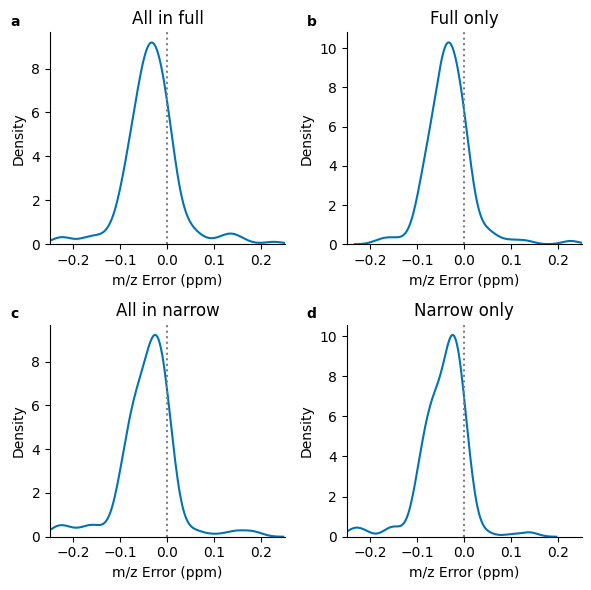

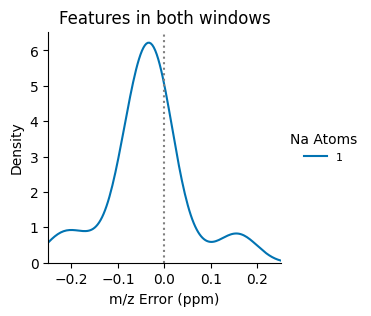

In [54]:
## Plot assignment error, Na, S, P, Fe, Cu atoms
data_df = spring_asgn

df_full = pd.concat([data_df.features_in_full_only, df_both[df_both['Window Size (m/z)'] == '1000']])
df_full = df_full[df_full['Cu']>0]
df_narrow = pd.concat([data_df.features_in_narrow_only, df_both[df_both['Window Size (m/z)'] == '200']])
df_narrow = df_narrow[df_narrow['Cu']>0]

dd = pd.concat([df_both, df_full,df_narrow])
el = 'Na'
xmin = -0.25
xmax = 0.25

fig, ((ax3,ax4),(ax5,ax6)) = plt.subplots(2, 2, figsize = (6,6))

ax = ax3
df = df_full[df_full[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend = False, hue=el,palette = sns.color_palette('colorblind')) #hue='N',
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('All in full')

ax = ax5
df = df_narrow[df_narrow[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend  = False, hue=el,palette = sns.color_palette('colorblind')) #
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_xlim(xmin,xmax)
ax.set_title('All in narrow')



ax = ax4
df = data_df.features_in_full_only[data_df.features_in_full_only['Cu']>0]
df = df[df[el]>0]
print(len(df))
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend = False, hue=el,palette = sns.color_palette('colorblind')) #hue='N',
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Full only')

ax = ax6
df = data_df.features_in_narrow_only[data_df.features_in_narrow_only['Cu']>0]
df = df[df[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, hue=el,palette = sns.color_palette('colorblind')) #hue='N',
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Narrow only')


lbls_art = []
lbls = ['a','b','c','d','e']
axs = [ax3,ax4,ax5,ax6]
for lbl, ax in zip(lbls,axs):
    l = ax.text(-0.15, 1.05,lbl,
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax.transAxes, fontweight='bold', fontsize = 10)
    lbls_art.append(l)


legend = ax6.get_legend()
handles = legend.legendHandles
legend.remove()
labels = [1,2,3,4]
#leg = fig.legend(handles, labels, bbox_to_anchor=(1.02, 0.5), loc='center left',frameon=False, borderaxespad=0, title = el +' Atoms', prop={'size': 8})

fig.tight_layout()

#plt.show()
sns.despine()
lbla, lblb, lblc, lbld= lbls_art
plt.savefig(svdir + 'mz_error_Cu_'+el+'_windows_spring-env.pdf', bbox_extra_artists=(lbla,lblb,lblc,lbld), bbox_inches='tight')


fig, ax = plt.subplots(figsize = (3,3))
df_both = data_df.features_in_both
df_both = df_both[df_both['Cu']>0]

df = df_both[df_both[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, hue=el,palette = sns.color_palette('colorblind'))
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Features in both windows')
legend = ax.get_legend()
handles = legend.legendHandles
legend.remove()
labels = [1,2,3,4]
ax.legend(handles, labels, bbox_to_anchor=(1.02, 0.5), loc='center left',frameon=False, borderaxespad=0, title = el+' Atoms', prop={'size': 8})
sns.despine()
plt.savefig(svdir + 'mz_error_Cu_'+el+'_BOTH_spring-env.pdf', bbox_inches='tight')



In [48]:
for i in _ih[-15:]:
    print(i)

## Plot assignment error, Na, S, P atoms
data_df = spring_asgn

df_full = pd.concat([data_df.features_in_full_only, df_both[df_both['Window Size (m/z)'] == '1000']])
df_narrow = pd.concat([data_df.features_in_narrow_only, df_both[df_both['Window Size (m/z)'] == '200']])

dd = pd.concat([df_both, df_full,df_narrow])
el = 'P'
xmin = -0.25
xmax = 0.25

fig, ((ax3,ax4),(ax5,ax6)) = plt.subplots(2, 2, figsize = (6,6))

ax = ax3
df = df_full[df_full[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend = False, hue=el,palette = sns.color_palette('colorblind')) #hue='N',
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('All in full')

ax = ax5
df = df_narrow[df_narrow[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend  = False, hue=el,palette = sns.color_palette('colorblind')) #
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_xlim(xmin,xmax)
ax.set_title('All in narrow')



ax = ax4
df = data_df.featur

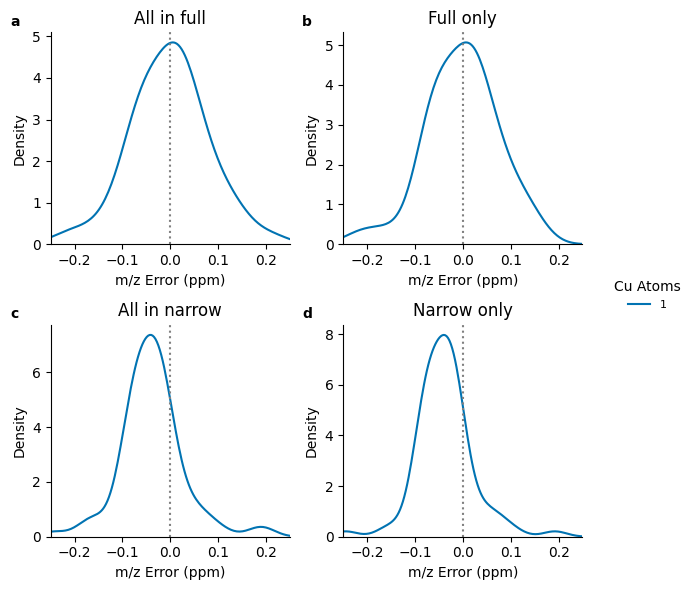

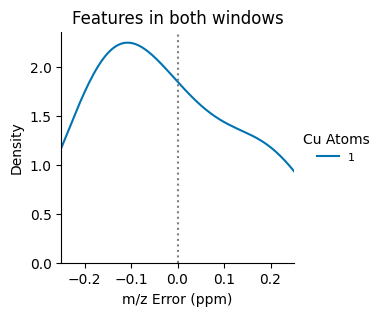

In [12]:
## Plot assignment error, Na, S, P, Fe, Cu atoms
data_df = spring_asgn

df_full = pd.concat([data_df.features_in_full_only, df_both[df_both['Window Size (m/z)'] == '1000']])
df_narrow = pd.concat([data_df.features_in_narrow_only, df_both[df_both['Window Size (m/z)'] == '200']])

dd = pd.concat([df_both, df_full,df_narrow])
el = 'Cu'
xmin = -0.25
xmax = 0.25

fig, ((ax3,ax4),(ax5,ax6)) = plt.subplots(2, 2, figsize = (6,6))

ax = ax3
df = df_full[df_full[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend = False, hue=el,palette = sns.color_palette('colorblind')) #hue='N',
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('All in full')

ax = ax5
df = df_narrow[df_narrow[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend  = False, hue=el,palette = sns.color_palette('colorblind')) #
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_xlim(xmin,xmax)
ax.set_title('All in narrow')



ax = ax4
df = data_df.features_in_full_only[data_df.features_in_full_only[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend = False, hue=el,palette = sns.color_palette('colorblind')) #hue='N',
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Full only')

ax = ax6
df = data_df.features_in_narrow_only[data_df.features_in_narrow_only[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, hue=el,palette = sns.color_palette('colorblind')) #hue='N',
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Narrow only')


lbls_art = []
lbls = ['a','b','c','d','e']
axs = [ax3,ax4,ax5,ax6]
for lbl, ax in zip(lbls,axs):
    l = ax.text(-0.15, 1.05,lbl,
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax.transAxes, fontweight='bold', fontsize = 10)
    lbls_art.append(l)


legend = ax6.get_legend()
handles = legend.legendHandles
legend.remove()
labels = [1,2,3,4]
leg = fig.legend(handles, labels, bbox_to_anchor=(1.02, 0.5), loc='center left',frameon=False, borderaxespad=0, title = el +' Atoms', prop={'size': 8})

fig.tight_layout()

#plt.show()
sns.despine()
lbla, lblb, lblc, lbld= lbls_art
plt.savefig(svdir + 'mz_error_'+el+'_windows_spring-env.pdf', bbox_extra_artists=(leg,lbla,lblb,lblc,lbld), bbox_inches='tight')


fig, ax = plt.subplots(figsize = (3,3))
df_both = data_df.features_in_both
df = df_both[df_both[el]>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, hue=el,palette = sns.color_palette('colorblind'))
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Features in both windows')
legend = ax.get_legend()
handles = legend.legendHandles
legend.remove()
labels = [1,2,3,4]
ax.legend(handles, labels, bbox_to_anchor=(1.02, 0.5), loc='center left',frameon=False, borderaxespad=0, title = el+' Atoms', prop={'size': 8})
sns.despine()
plt.savefig(svdir + 'mz_error_'+el+'_BOTH_spring-env.pdf', bbox_inches='tight')



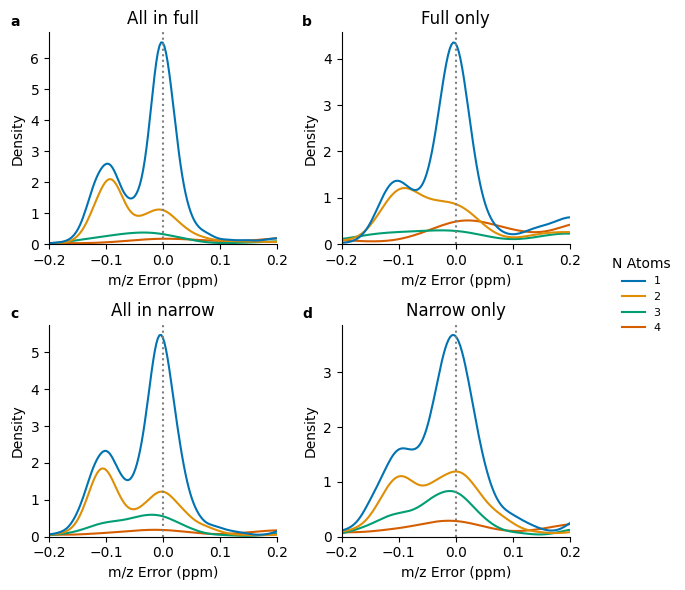

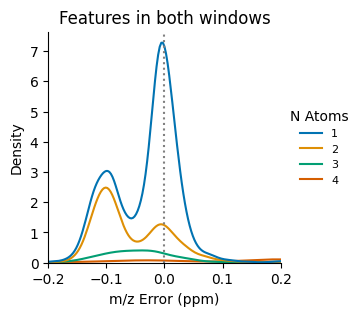

In [31]:
## Plot assignment error, N atoms
data_df = spring_asgn

df_full = pd.concat([data_df.features_in_full_only, df_both[df_both['Window Size (m/z)'] == '1000']])
df_narrow = pd.concat([data_df.features_in_narrow_only, df_both[df_both['Window Size (m/z)'] == '200']])

dd = pd.concat([df_both, df_full,df_narrow])

molclass = ['CHO', 'CHON']

xmin = -0.2
xmax = 0.2

fig, ((ax3,ax4),(ax5,ax6)) = plt.subplots(2, 2, figsize = (6,6))

ax = ax3
df = df_full[df_full['N']>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend = False, hue='N',palette = sns.color_palette('colorblind')) #hue='N',
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('All in full')

ax = ax5
df = df_narrow[df_narrow['N']>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend  = False, hue='N',palette = sns.color_palette('colorblind')) #
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_xlim(xmin,xmax)
ax.set_title('All in narrow')



ax = ax4
df = data_df.features_in_full_only[data_df.features_in_full_only['N']>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, legend = False, hue='N',palette = sns.color_palette('colorblind')) #hue='N',
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Full only')

ax = ax6
df = data_df.features_in_narrow_only[data_df.features_in_narrow_only['N']>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, hue='N',palette = sns.color_palette('colorblind')) #hue='N',
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Narrow only')


lbls_art = []
lbls = ['a','b','c','d','e']
axs = [ax3,ax4,ax5,ax6]
for lbl, ax in zip(lbls,axs):
    l = ax.text(-0.15, 1.05,lbl,
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax.transAxes, fontweight='bold', fontsize = 10)
    lbls_art.append(l)


legend = ax6.get_legend()
handles = legend.legendHandles
legend.remove()
labels = [1,2,3,4]
leg = fig.legend(handles, labels, bbox_to_anchor=(1.02, 0.5), loc='center left',frameon=False, borderaxespad=0, title = 'N Atoms', prop={'size': 8})

fig.tight_layout()

#plt.show()
sns.despine()
lbla, lblb, lblc, lbld= lbls_art
plt.savefig(svdir + 'mz_error_N_windows_spring-env.pdf', bbox_extra_artists=(leg,lbla,lblb,lblc,lbld), bbox_inches='tight')


fig, ax = plt.subplots(figsize = (3,3))
df_both = data_df.features_in_both
df = df_both[df_both['N']>0]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)', ax=ax, hue='N',palette = sns.color_palette('colorblind'))
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Features in both windows')
legend = ax.get_legend()
handles = legend.legendHandles
legend.remove()
labels = [1,2,3,4]
ax.legend(handles, labels, bbox_to_anchor=(1.02, 0.5), loc='center left',frameon=False, borderaxespad=0, title = 'N Atoms', prop={'size': 8})
sns.despine()
plt.savefig(svdir + 'mz_error_N_BOTH_spring-env.pdf', bbox_inches='tight')



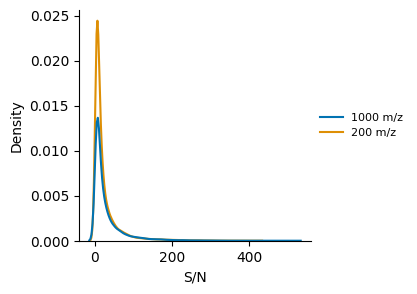

In [70]:
## PLOT DBE KDEs error for both windows

data_df = spring_asgn

df_both = data_df.features_in_both
df_full = pd.concat([data_df.features_in_full_only, df_both[df_both['Window Size (m/z)'] == '1000']])
df_narrow = pd.concat([data_df.features_in_narrow_only, df_both[df_both['Window Size (m/z)'] == '200']])

dd = pd.concat([df_full,df_narrow])


"""xmin = -1
xmax = 20"""

c='S/N'
hc = 'Window Size (m/z)'

fig, ax = plt.subplots(figsize = (3,3))

ax = sns.kdeplot(data=dd,x=c, ax=ax, hue=hc,palette = sns.color_palette('colorblind'), legend = True)
#ax.set_xlim(xmin,xmax)


legend = ax.get_legend()
handles = legend.legendHandles
labels = ['1000 m/z', '200 m/z']
ax.legend(handles, labels, bbox_to_anchor=(1.02, 0.5), loc='center left',frameon=False, borderaxespad=0,  prop={'size': 8})
sns.despine()
c = 'SN'
plt.savefig(svdir + 'mz_error_'+c+'_BOTH_spring-env.pdf', bbox_inches='tight')



In [ ]:


fig, ((ax3,ax4),(ax5,ax6)) = plt.subplots(2, 2, figsize = (6,6))

ax = ax3
ax = sns.kdeplot(data=df,x='DBE',hue=hc, ax=ax, legend = False, palette = sns.color_palette('colorblind'))
ax.set_xlim(xmin,xmax)
ax.set_title('All in full')

ax = ax5
ax = sns.kdeplot(data=df,x='DBE',hue=hc, ax=ax, legend  = False, palette = sns.color_palette('colorblind'))
ax.set_xlim(xmin,xmax)
ax.set_title('All in narrow')



ax = ax4
df = data_df.features_in_full_only[data_df.features_in_full_only['mol_class'].isin(molclass)]
ax = sns.kdeplot(data=df,x='DBE',hue=hc, ax=ax, legend = False, palette = sns.color_palette('colorblind'))
ax.set_xlim(xmin,xmax)
ax.set_title('Full only')

ax = ax6
df = data_df.features_in_narrow_only[data_df.features_in_narrow_only['mol_class'].isin(molclass)]
ax = sns.kdeplot(data=df,x='DBE',hue=hc, ax=ax, palette = sns.color_palette('colorblind'))
ax.set_xlim(xmin,xmax)
ax.set_title('Narrow only')

lbls_art = []
lbls = ['a','b','c','d','e']
axs = [ax3,ax4,ax5,ax6]
for lbl, ax in zip(lbls,axs):
    l = ax.text(-0.15, 1.05,lbl,
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax.transAxes, fontweight='bold', fontsize = 10)
    lbls_art.append(l)


legend = ax6.get_legend()
handles = legend.legendHandles
legend.remove()
labels = molclass
leg = fig.legend(handles, labels, bbox_to_anchor=(1.02, 0.5), loc='center left',frameon=False, borderaxespad=0, title = 'Mol. Class', prop={'size': 8})

fig.tight_layout()

#plt.show()
sns.despine()
lbla, lblb, lblc, lbld= lbls_art
plt.savefig(svdir + 'mz_error_DBE_windows_spring-env.pdf', bbox_extra_artists=(leg,lbla,lblb,lblc,lbld), bbox_inches='tight')


fig, ax = plt.subplots(figsize = (3,3))
df_both = data_df.features_in_both

ax = sns.kdeplot(data=df,x='DBE', ax=ax, hue=el,palette = sns.color_palette('colorblind'), legend = False)
ax.set_xlim(xmin,xmax)
ax.set_title('Features in both windows')
legend = ax.get_legend()
handles = legend.legendHandles
legend.remove()
labels = [1,2,3,4]
ax.legend(handles, labels, bbox_to_anchor=(1.02, 0.5), loc='center left',frameon=False, borderaxespad=0, title = el+' Atoms', prop={'size': 8})
sns.despine()
plt.savefig(svdir + 'mz_error_'+el+'_BOTH_spring-env.pdf', bbox_inches='tight')

6976
4135
5269
599.2851976743202


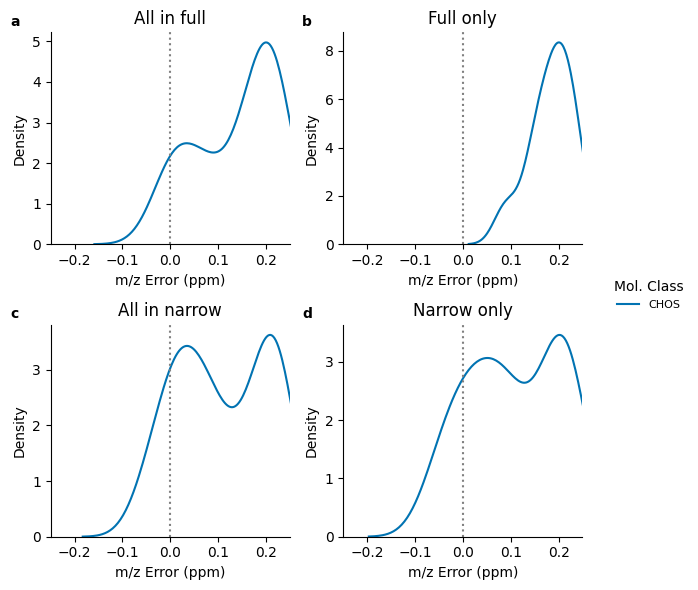

In [9]:
## PLOT CHO, CHON error for both windows

data_df = spring_asgn

df_both = data_df.features_in_both
df_full = pd.concat([data_df.features_in_full_only, df_both[df_both['Window Size (m/z)'] == '1000']])
df_narrow = pd.concat([data_df.features_in_narrow_only, df_both[df_both['Window Size (m/z)'] == '200']])

print(len(df_both))
print(len(df_full))
print(len(df_narrow))

print(max(df_full['m/z']))
dd = pd.concat([df_both, df_full,df_narrow])

molclass = [ 'CHOS']

xmin = -0.25
xmax = 0.25

hc = 'mol_class'

fig, ((ax3,ax4),(ax5,ax6)) = plt.subplots(2, 2, figsize = (6,6))

ax = ax3
df = df_full[df_full['mol_class'].isin(molclass)]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)',hue=hc, ax=ax, legend = False, palette = sns.color_palette('colorblind'))
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('All in full')

ax = ax5
df = df_narrow[df_narrow['mol_class'].isin(molclass)]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)',hue=hc, ax=ax, legend  = False, palette = sns.color_palette('colorblind'))
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_xlim(xmin,xmax)
ax.set_title('All in narrow')



ax = ax4
df = data_df.features_in_full_only[data_df.features_in_full_only['mol_class'].isin(molclass)]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)',hue=hc, ax=ax, legend = False, palette = sns.color_palette('colorblind'))
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Full only')

ax = ax6
df = data_df.features_in_narrow_only[data_df.features_in_narrow_only['mol_class'].isin(molclass)]
ax = sns.kdeplot(data=df,x='m/z Error (ppm)',hue=hc, ax=ax, palette = sns.color_palette('colorblind'))
ax.axvline(0, color = 'gray', linestyle = ':')
ax.set_xlim(xmin,xmax)
ax.set_title('Narrow only')

lbls_art = []
lbls = ['a','b','c','d','e']
axs = [ax3,ax4,ax5,ax6]
for lbl, ax in zip(lbls,axs):
    l = ax.text(-0.15, 1.05,lbl,
        horizontalalignment='center',
        verticalalignment='center',
        transform = ax.transAxes, fontweight='bold', fontsize = 10)
    lbls_art.append(l)


legend = ax6.get_legend()
handles = legend.legendHandles
legend.remove()
labels = molclass
leg = fig.legend(handles, labels, bbox_to_anchor=(1.02, 0.5), loc='center left',frameon=False, borderaxespad=0, title = 'Mol. Class', prop={'size': 8})

fig.tight_layout()

#plt.show()
sns.despine()
lbla, lblb, lblc, lbld= lbls_art
plt.show()
#plt.savefig(svdir + 'mz_error_CHO_CHON_windows_spring-env.pdf', bbox_extra_artists=(leg,lbla,lblb,lblc,lbld), bbox_inches='tight')

In [ ]:


'''df_nrw_al = pd.concat([df_narrow, df_both[df_both['Window Size (m/z)']=='200']])
df_nrw_al = df_nrw_al[(df_nrw_al['Cu']>0)&(df_nrw_al['Na']==1) &(df_nrw_al['P']>=0) &
                      (df_nrw_al['S']<=10) &(df_nrw_al['Fe']==0) &(df_nrw_al['N']<=4)]'''


'''print(len(df_full[df_full['Cu']==1]), len(df_narrow[df_narrow['Cu']==1]), print(len(df_both[df_both['Cu']>0])))
ddf = df_full[(df_full['Cu']==1) & (df_full['Na']==1) & (df_full['P']>=0)  &
               (df_full['S']<=15)  & (df_full['N']<=4) & (df_full['Fe']==0)]
ddf['DetectedIn'] = 'Full Only'
ddn = df_narrow[(df_narrow['Cu']==1) & (df_narrow['Na']==0) & (df_narrow['P']<=0) & (df_narrow['S']<=1) & (df_narrow['N']>=4) & (df_narrow['Fe']==0)]
ddn['DetectedIn'] = 'Narrow Only'
ddb = df_both[(df_both['Cu']>0) & (df_both['Na']==0) & (df_both['P']<=0) & (df_both['S']<=1)& (df_both['N']>=4) & (df_both['Fe']==0)]
ddb['DetectedIn'] = 'Both'''


#['mol_class'].isin(['CHO','CHON'])
df_full = df_full[df_full['Fe']>0]
df_full = df_full[df_full['N']>0]
df_full = df_full[df_full['Na']==0]
df_full = df_full[df_full['P']==0]
df_full = df_full[df_full['S']==0]


df_narrow = df_narrow[df_narrow['Fe']>0]
df_narrow = df_narrow[df_narrow['N']>0]
df_narrow = df_narrow[df_narrow['Na']==0]
df_narrow = df_narrow[df_narrow['P']==0]
df_narrow = df_narrow[df_narrow['S']==0]


df_both = df_both[df_both['Fe']>0]
df_both = df_both[df_both['N']>0]
df_both = df_both[df_both['Na']==0]
df_both = df_both[df_both['P']==0]
df_both = df_both[df_both['S']==0]
print(len(df_full))
print(len(df_narrow))
print(len(df_both))
dd = pd.concat([df_both, df_full,df_narrow])

sns.kdeplot(data=dd, x = 'm/z Error (ppm)', palette = sns.color_palette('colorblind'),hue = 'FeatureIn')

#sns.kdeplot(data=df_nrw_al, x = 'm/z Error (ppm)', color = 'red')

plt.axvline(0, linestyle = ':', color='gray')



243 Cu assignments
4 Cu assignments with 1 N
5 Cu assignments wit 2 N
10 Cu assignments with 3 N
152 Cu assignments with 4 N

244 Cu assignments
49 Cu assignments with 1 N
18 Cu assignments wit 2 N
25 Cu assignments with 3 N
71 Cu assignments with 4 N



"\nelement = 'P'\n\nprint('%s Cu assignments in full (400-600 mz)' %len(df_full))\nprint('%s Cu assignments in nrw (400-600 mz)' %len(df_narrow))\n\nprint('%s Cu with %s in full (400-600 mz)' %(len(df_full[df_full[element]>=1]), element))\n\nprint('\n%s Cu with %s in nrw (400-600 mz)' %(len(df_narrow[df_narrow[element]>=1]), element))"

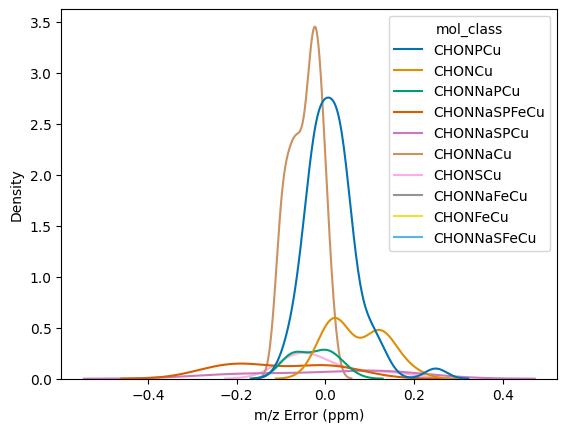

In [38]:


for df in [df_full, df_narrow]:

    df1 = df[df['Cu']>0]
    print('%s Cu assignments' %len(df1))
    df2 = df1[df1['N']==1]
    print('%s Cu assignments with 1 N' %len(df2))
    df3 = df1[(df1['N']==2) ]
    print('%s Cu assignments wit 2 N' %len(df3))
    df4 = df1[(df1['N']==3) ]
    print('%s Cu assignments with 3 N' %len(df4))
    df5 = df1[df1['N'] == 4]
    print('%s Cu assignments with 4 N\n' %len(df5))


dd = pd.concat([ df5, df3, df4, df2])
sns.kdeplot(data=dd, x = 'm/z Error (ppm)', palette = sns.color_palette('colorblind'), hue='mol_class')


data_df = spring_asgn

df_full = data_df.features_in_both[ (data_df.features_in_both['Window Size (m/z)']=='1000') 
                                   &(data_df.features_in_both['Cu'] >=1) ]

df_narrow = pd.concat([data_df.features_in_both[ (data_df.features_in_both['Window Size (m/z)']=='200')], 
                        data_df.features_in_narrow_only])
df_narrow = df_narrow[df_narrow['Cu']>=1]
'''
element = 'P'

print('%s Cu assignments in full (400-600 mz)' %len(df_full))
print('%s Cu assignments in nrw (400-600 mz)' %len(df_narrow))

print('%s Cu with %s in full (400-600 mz)' %(len(df_full[df_full[element]>=1]), element))

print('\n%s Cu with %s in nrw (400-600 mz)' %(len(df_narrow[df_narrow[element]>=1]), element))'''


140 Cu assignments
24 Cu assignments with 1 N
16 Cu assignments wit 2 N
26 Cu assignments with 3 N
28 Cu assignments with 4 N

331 Cu assignments
66 Cu assignments with 1 N
20 Cu assignments wit 2 N
25 Cu assignments with 3 N
104 Cu assignments with 4 N

70 Cu assignments in full (400-600 mz)
401 Cu assignments in nrw (400-600 mz)
30 Cu with P in full (400-600 mz)

146 Cu with P in nrw (400-600 mz)


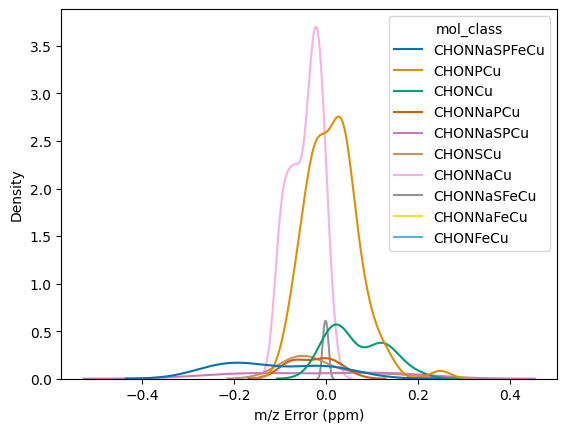

In [46]:
data_df = spring_asgn

df_full = data_df.features_in_both

df_narrow = data_df.features_in_narrow_only


for df in [df_full, df_narrow]:

    df1 = df[df['Cu']>0]
    print('%s Cu assignments' %len(df1))
    df2 = df1[df1['N']==1]
    print('%s Cu assignments with 1 N' %len(df2))
    df3 = df1[(df1['N']==2) ]
    print('%s Cu assignments wit 2 N' %len(df3))
    df4 = df1[(df1['N']==3) ]
    print('%s Cu assignments with 3 N' %len(df4))
    df5 = df1[df1['N'] == 4]
    print('%s Cu assignments with 4 N\n' %len(df5))


dd = pd.concat([ df5, df3, df4, df2])
sns.kdeplot(data=dd, x = 'm/z Error (ppm)', palette = sns.color_palette('colorblind'), hue='mol_class')


data_df = spring_asgn

df_full = data_df.features_in_both[ (data_df.features_in_both['Window Size (m/z)']=='1000') 
                                   &(data_df.features_in_both['Cu'] >=1) ]

df_narrow = pd.concat([data_df.features_in_both[ (data_df.features_in_both['Window Size (m/z)']=='200')], 
                        data_df.features_in_narrow_only])
df_narrow = df_narrow[df_narrow['Cu']>=1]

element = 'P'

print('%s Cu assignments in full (400-600 mz)' %len(df_full))
print('%s Cu assignments in nrw (400-600 mz)' %len(df_narrow))

print('%s Cu with %s in full (400-600 mz)' %(len(df_full[df_full[element]>=1]), element))

print('\n%s Cu with %s in nrw (400-600 mz)' %(len(df_narrow[df_narrow[element]>=1]), element))


In [ ]:
### make KDE error plots for Cu in Spring-ENV 

def plot_CuN_KDE():
        windows = ['narrow', 'full', 'both']

        xpltl = -0.1
        ypltl = 1.1
        fig,( ax , ax2)= plt.subplots(2,1, figsize=(2.7,4.8))

        ax = plotErrorKde_el(ax,spring_asgn,element1='Cu',element2='N', window = windows[1], max1 = 1, min2 = 1, max2=5)
        #ax = plotErrorKde_el(ax,spring_asgn,element1='C',element2='N', window = windows[1], max1 = 50, min2 = 4, max2=4)

        ax.set_title('1000 m/z window',size=11)
        ax.tick_params(axis='x', labelsize=8)
        ax.tick_params(axis='y', labelsize=8)
        ax.yaxis.set_major_locator(MultipleLocator(1))
        ax.yaxis.set_minor_locator(MultipleLocator(0.25))
        legend = ax.get_legend()
        legend.remove()
        

        '''handles = legend.legendHandles
        labels = [str(i) for i in range(1,5)]
        ax.legend(handles,labels, bbox_to_anchor=(1.0, 0.5), loc='center right',frameon=False, borderaxespad=0, title = 'N atoms', prop={'size': 10})'''

        ax2 = plotErrorKde_el(ax2,spring_asgn,element1='Cu',element2='N', window = windows[0], max1 = 1, min2 = 1, max2=5)
        #ax2 = plotErrorKde_el(ax2,spring_asgn,element1='C',element2='Cu', window = windows[1], max1 = 50, min2 = 1, max2=1)
        ax2.set_title('200 m/z window',size=11)
        legend = ax2.get_legend()
        handles = legend.legendHandles
        labels = [str(i) for i in range(1,5)]
        legend.remove()
        ax2.tick_params(axis='x', labelsize=8)
        ax2.tick_params(axis='y', labelsize=8)
        ax2.yaxis.set_major_locator(MultipleLocator(1))
        ax2.yaxis.set_minor_locator(MultipleLocator(0.25))

        ax = ax 
        lbla =ax.text(xpltl, ypltl,'a',
                horizontalalignment='center',
                verticalalignment='center',
                transform = ax.transAxes, fontweight='bold', fontsize = 12)

        ax =ax2 
        lblb = ax.text(xpltl, ypltl,'b',
                horizontalalignment='center',
                verticalalignment='center',
                transform = ax.transAxes, fontweight='bold', fontsize = 12)
        leg = fig.legend(handles,labels, bbox_to_anchor=(1.0, 0.55), loc='center left',frameon=False, borderaxespad=0, title = 'N atoms', prop={'size': 8})
        sns.despine()

        fig.tight_layout()
        #plt.show()
        plt.savefig(svdir + 'kde_Cu_N_spring-env_nrw&full.pdf', bbox_extra_artists=(lblb,lbla, leg),bbox_inches='tight')



In [ ]:
data_df = spring_asgn

df_full = data_df.features_in_both[ (data_df.features_in_both['Window Size (m/z)']=='1000')]

df_narrow = pd.concat([data_df.features_in_both[ (data_df.features_in_both['Window Size (m/z)']=='200')], 
                        data_df.features_in_narrow_only])

print('%s CHO in full (400-600 mz)' %len(df_full[df_full['mol_class']=='CHO']))
print('%s CHON in full (400-600 mz)' %len(df_full[df_full['mol_class']=='CHON']))
print('%s other in full (400-600 mz)' %len(df_full[(df_full['mol_class']!='CHON')&(df_full['mol_class']!='CHO')]))

print('%s CHO in nrw (400-600 mz)' %len(df_narrow[df_narrow['mol_class']=='CHO']))
print('%s CHON in nrw (400-600 mz)' %len(df_narrow[df_narrow['mol_class']=='CHON']))
print('%s other in nrw (400-600 mz)' %len(df_narrow[(df_narrow['mol_class']!='CHON')&(df_narrow['mol_class']!='CHO')]))

print(df_narrow['mol_class'].unique())
print(df_full['mol_class'].unique())


In [ ]:
data_df = spring_asgn

df_full = data_df.features_in_both[ (data_df.features_in_both['Window Size (m/z)']=='1000') &(data_df.features_in_both['Cu'] >=1) ]

df_narrow = pd.concat([data_df.features_in_both[ (data_df.features_in_both['Window Size (m/z)']=='200')], 
                        data_df.features_in_narrow_only])
df_narrow = df_narrow[df_narrow['Cu']>=1]

element = 'P'

print('%s Cu assignments in full (400-600 mz)' %len(df_full))
print('%s Cu assignments in nrw (400-600 mz)' %len(df_narrow))

print('%s Cu with %s in full (400-600 mz)' %(len(df_full[df_full[element]>=1]), element))

print('\n%s Cu with %s in nrw (400-600 mz)' %(len(df_narrow[df_narrow[element]>=1]), element))


In [ ]:
### make mz v. error ppm plots

plotMzVError(spring_asgn, element1='Na', element2='S')

plotMzVError(wastewater_asgn, element1='N', element2='Cl')

In [ ]:
make_S_VKpanels(wastewater_asgn) 
make_I_VKpanels(wastewater_asgn)
make_F_VKpanels(wastewater_asgn)

In [ ]:
make_Cu_VKpanels(spring_asgn)

In [ ]:
make_N_VKpanels(spring_asgn)
make_N_VKpanels(wastewater_asgn)

In [ ]:
element1 = 'Cu'
element2 = 'N'
max1 = 1
max2 = 5
min2 = 4
data_df = spring_asgn
n = 4
df_cu_full = data_df.features_in_both[(data_df.features_in_both['Cu']>0) & (data_df.features_in_both['Window Size (m/z)']=='1000')]
df = df_cu_full[df_cu_full['N']==n]
print(np.shape(df))

df_cu_narrow = pd.concat([data_df.features_in_both[(data_df.features_in_both['Cu']>0) & (data_df.features_in_both['Window Size (m/z)']=='200')], data_df.features_in_narrow_only[data_df.features_in_narrow_only['Cu']>0]])
df = df_cu_narrow[df_cu_narrow['N']==n]
print(np.shape(df))

In [ ]:
unique_fullmz_range = spring_asgn.features_in_both
unique_fullmz_range = unique_fullmz_range[(unique_fullmz_range[element1]>0) & (unique_fullmz_range[element1]<=max1) & (unique_fullmz_range[element2]>=min2) & (unique_fullmz_range[element2]<=max2)]
print(np.shape(unique_fullmz_range))
print(unique_fullmz_range['N'])

In [ ]:
sns.color_palette('colorblind') 


In [ ]:
plot_CuN_KDE()

In [ ]:
from matplotlib.backends.backend_pdf import PdfPages

icpms_file = '/Users/christiandewey/Library/CloudStorage/Box-Box/Boiteau Lab/Mass Spec Data/Keck iCAP Q/2022/2022-09/Tillamook, Sept 2022/spring_env.csv'
icpms = pd.read_csv(icpms_file, sep=';',header=1)


metals = ['63Cu','56Fe']

fig, ax = plt.subplots()

maxicp = 0 
for me in metals:
    me_key = 'Time %s' %me
    ax.plot(icpms[me_key]/60, icpms[me], label=me)        
    



#ax.set_ylim(0,maxicp*1.1)
ax.set_title('Spring (ENV)')
ax.set_xlabel('Time (min)')
ax.set_ylabel('ICP-MS signal (cps)')
ax.legend(bbox_to_anchor=(1.05,0.5),loc='center left',frameon =False)
ax.set_xlim(0,30)
ax.set_ylim(bottom = 0)

x = np.arange(0.0, 4, 0.01)
ax.fill_between(x, 0,1e6,  color = 'gray',alpha=0.5)
x = np.arange(24, 30, 0.01)
ax.fill_between(x, 0,1e6, color = 'gray', alpha=0.5)
current_yvalues = plt.gca().get_yticks()
ylabs = []
for y in current_yvalues:
    if y == 0:
        d = int(0)
    else:
        d = '{:.1f} x $10^5$'.format(y/1e5)
    ylabs.append(d)
#plt.gca().set_yticklabels(['{:.1f} x $10^5$'.format(y/1e5) for y in current_yvalues])
plt.gca().set_yticklabels(ylabs)
fig.tight_layout()
plt.show()

In [ ]:
from matplotlib.backends.backend_pdf import PdfPages

flist = ['slough_env.csv']  #'spring_env.csv',
title = 'DOM-Cu'
#flist = ['spring_ppl.csv','slough_ppl.csv']
#title = 'PPL SPE Column'
labels = ['Slough'] #'Seep', 
alphas = [1,0.5]
labs = {f:l for f,l in zip(flist,labels)}
transp = {f:a for f,a in zip(flist,alphas)}

dir = '/Users/christiandewey/Library/CloudStorage/Box-Box/Boiteau Lab/Mass Spec Data/Keck iCAP Q/2022/2022-09/Tillamook, Sept 2022/'

metals = ['63Cu']
colors = ['C0', 'C1']
cols = {m:c for m,c in zip(metals,colors)}


fig, ax = plt.subplots()

for me in metals:

    maxicp = 0 

    for f in flist:

        icpms_file = dir + f
        icpms = pd.read_csv(icpms_file, sep=';',header=1)
        mw = me[:2]
        sym = me[2:]
        plab = '$^{%s}$%s' %(mw,sym)
        me_key = 'Time %s' %me
        ax.plot(icpms[me_key]/60, icpms[me], label=plab+', '+labs[f],color = cols[me], alpha = transp[f])        
        

#ax.set_ylim(0,maxicp*1.1)
#ax.set_title(title)
ax.set_xlabel('Time (min)')
ax.set_ylabel('ICP-MS signal (cps)')
#ax.legend(bbox_to_anchor=(1.05,0.5),loc='center left',frameon =False)
ax.legend(bbox_to_anchor=(1.0,1.0),loc='upper right')

ax.set_xlim(0,30)
ax.set_ylim(bottom = 0, top = 1.25e5)
ax.yaxis.set_major_locator(MultipleLocator(2.5e4))

'''x = np.arange(0.0, 4, 0.01)
ax.fill_between(x, 0,1e6,  color = 'gray',alpha=0.5)
x = np.arange(24, 30, 0.01)
ax.fill_between(x, 0,1e6, color = 'gray', alpha=0.5)'''
current_yvalues = plt.gca().get_yticks()
ylabs = []
for y in current_yvalues:
    if y == 0:
        d = int(0)
    else:
        d = '{:.1f} x $10^5$'.format(y/1e5)
    ylabs.append(d)
#plt.gca().set_yticklabels(['{:.1f} x $10^5$'.format(y/1e5) for y in current_yvalues])
plt.gca().set_yticklabels(ylabs)


fig.tight_layout()
plt.show()

In [ ]:
from tabulate import tabulate
geochem = pd.DataFrame(columns = ['Seep', 'Slough'], index = ['pH', 'Conductivity (mS/cm)','DO (mg/L)','T (C)','Total Cu (uM)', 'Total Fe (uM)', 'DOC (mM)'])

seep = [5.5, 1000,0.1, 8, 100,200,4]
slough = [7.2, 200,8, 8, 50,100,3]

geochem['Seep'] = seep
geochem['Slough'] = slough

geochem

ctest = tabulate(geochem, headers=['Seep', 'Slough'], tablefmt='latex')




In [ ]:
alldf = pd.concat([unique_fullmz_456, unique_200mz])
#alldf = unique_100mz_456

times = data_df['Time'].unique()

holder = {}
summary = []
summary2 = []

for mzw in alldf['m/z Window Size'].unique():
    
    sub1 = alldf[alldf['m/z Window Size'] == mzw]

    for t in times:
        
        print(mzw)
        lsh = {}
        lsh['m/z Window Size'] = mzw

        sub2 = sub1[sub1['Time'] == t]

        sub2 = sub2[sub2['S/N'] > 3]
        
        dynamic_range_t = max(sub2['Peak Height']/min(sub2['Peak Height']))
        
        lsh['Time'] = t
        lsh['Dynamic Range'] = dynamic_range_t        
        lsh['n Features'] = len(sub2)
        lsh['Max I'] = max(sub2['Peak Height'])
        lsh['Min I'] = min(sub2['Peak Height'])
        summary.append(lsh)


df=pd.DataFrame(summary)

sns.boxplot(data=df, x="Dynamic Range", y="m/z Window Size")

In [ ]:

pdf = PdfPages('/Users/christiandewey/Library/CloudStorage/Box-Box/data/assignments/spring/eics_cu_100mz_fullmz-dec13.pdf')

fig, ax = plt.subplots()

maxicp = 0 
for me in metals:
    me_key = 'Time %s' %me
    ax.plot(icpms[me_key]/60, icpms[me], label=me)        
    



#ax.set_ylim(0,maxicp*1.1)
ax.set_title('Cu ICPMS Trace')
ax.set_xlabel('Time (min)')
ax.set_ylabel('ICPMS signal (cps)')
ax.legend(bbox_to_anchor=(1.05,0.5),loc='center left',frameon =False)
ax.set_xlim(2,30)
fig.tight_layout()
pdf.savefig()

for mf in mz100_EICdic:   

    fig, ax = plt.subplots()
    
    eict=mz100_EICdic[mf].time
    eics=mz100_EICdic[mf].eic

    inds = np.where(np.asarray(eict)<28)

    eict = np.asarray(eict)[inds]
    eics = np.asarray(eics)[inds]

    ax.plot(eict, eics,color = 'red', label=r'$\Delta$m/z 100 window')

    if mf in fullmz_EICdic:
        eic2t = fullmz_EICdic[mf].time
        eic2s = fullmz_EICdic[mf].eic

        eic2t = np.asarray(eic2t)[inds]
        eic2s = np.asarray(eic2s)[inds]
        ax.plot(eic2t,eic2s, color ='C0', label = 'full window')
    ax.set_xlim(4,28)
    ax.set_title(mf)
    ax.legend(frameon = False,bbox_to_anchor=(1.05,0.5),loc='center left')
    fig.tight_layout()
    pdf.savefig()

for mf in fullmz_EICdic:   

    if mf not in mz100_EICdic:

        fig, ax = plt.subplots()

        eic2t = fullmz_EICdic[mf].time
        eic2s = fullmz_EICdic[mf].eic

        inds = np.where(np.asarray(eic2t)<28)

        eic2t = np.asarray(eic2t)[inds]
        eic2s = np.asarray(eic2s)[inds]
        ax.plot(eic2t,eic2s, color ='C5', label = 'full window')

        ax.set_xlim(4,28)
        ax.set_title(mf)
        ax.legend(frameon = False,bbox_to_anchor=(1.05,0.5),loc='center left')
        fig.tight_layout()
        pdf.savefig()

pdf.close()